<a href="https://colab.research.google.com/github/vatsala-singh/NLP/blob/main/TransformerforIndianLanguage.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Initial Experiments

In [ ]:
from transformers import XLMRobertaModel, XLMRobertaTokenizer
import torch

# Load pre-trained XLM-RoBERTa model and tokenizer
model_name = "xlm-roberta-base"
tokenizer = XLMRobertaTokenizer.from_pretrained(model_name)
model = XLMRobertaModel.from_pretrained(model_name)


/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


tokenizer_config.json:   0%|          | 0.00/25.0 [00:00<?, ?B/s]

sentencepiece.bpe.model:   0%|          | 0.00/5.07M [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/9.10M [00:00<?, ?B/s]

config.json:   0%|          | 0.00/615 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/1.12G [00:00<?, ?B/s]

In [ ]:
# Sample Hindi text
text = "यह एक उदाहरण वाक्य है।"

# Tokenize the text and convert to input IDs and attention mask
inputs = tokenizer(text, return_tensors="pt", padding=True, truncation=True)

In [ ]:
# Get the embeddings from the model
with torch.no_grad():
    outputs = model(**inputs)

# Extract the last hidden state
embeddings = outputs.last_hidden_state


In [ ]:
# Option 1: Use the CLS token embedding (first token)
sentence_embedding = embeddings[:, 0, :]

# Option 2: Mean Pooling
sentence_embedding = embeddings.mean(dim=1)

In [ ]:
print(sentence_embedding)

tensor([[ 5.1672e-02,  1.6213e-02,  1.6500e-02,  2.7170e-02,  9.8175e-02,
         -4.9058e-02,  7.1119e-03, -3.4164e-02,  2.7472e-02,  6.5802e-03,
          1.8648e-02,  4.7348e-02,  2.4810e-01,  9.8813e-02,  1.7096e-02,
         -6.9239e-03, -1.5309e-02, -2.4971e-02,  1.8302e-03,  9.8413e-03,
          2.3299e-02,  7.1431e-02,  5.6512e-02,  5.5997e-02,  2.6804e-02,
         -2.7964e-02,  1.3341e-03,  3.0760e-02, -8.0467e-03,  5.1424e-02,
          6.5764e-02, -3.8760e-02,  3.7372e-02,  1.5425e-03,  6.6779e-04,
         -7.6150e-02, -8.7603e-02, -6.5005e-02,  1.0451e-01,  4.5604e-02,
          6.8352e-02,  1.0923e-01,  2.5287e-02,  7.3734e-03,  7.4592e-03,
         -6.2460e-03,  3.7406e-02, -2.9455e-02,  1.6130e-02, -5.7776e-02,
          8.7974e-02, -1.6882e-01,  5.1799e-02,  6.9749e-02, -1.0299e-01,
         -8.4690e-02,  7.3908e-02, -3.2417e-02,  6.7696e-02,  4.8245e-02,
         -1.4148e-02,  7.2644e-02,  3.7941e-02,  3.0672e-02,  3.3131e-02,
         -2.6392e-03, -7.6241e-02, -6.

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

**Comparing Word Embeddings from different Techniques**

- Distributed language representation
- Deep learning techniques us already pre-trained word representations - word embedding
- Implement state of the art word embedding methods to perform intrinsic evaluation on word simillarity
-

**Reference**

[Comparative Analysis of Word Embeddings for Capturing Word Similarities.](https://aircconline.com/csit/papers/vol10/csit100402.pdf)
[The Ability of Word Embeddings to Capture Word Similarities](https://aircconline.com/ijnlc/V9N3/9320ijnlc02.pdf)

https://github.com/mtoshevska/Comparing-Embeddings
https://www.turing.com/kb/guide-on-word-embeddings-in-nlp

https://github.com/mtoshevska/Comparing-Embeddings

# **Embeddings and More**

Import Libraries

In [ ]:
https://www.geeksforgeeks.org/python-word-embedding-using-word2vec/

In [ ]:
from gensim.models import word2vec
import nltk
import re
from nltk.corpus import stopwords

In [ ]:
from nltk.tokenize import sent_tokenize, word_tokenize

In [ ]:
import gensim

In [ ]:
nltk.download('punkt_tab')

[nltk_data] Downloading package punkt_tab to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt_tab.zip.


True

## Data Collection

In [ ]:
corpus = open("/content/drive/MyDrive/NLP_Text_Gutenber")
data = corpus.read()

In [ ]:
data

'*** START OF THE PROJECT GUTENBERG EBOOK 11 ***\n[Illustration]\n\n\n\n\nAlice’s Adventures in Wonderland\n\nby Lewis Carroll\n\nTHE MILLENNIUM FULCRUM EDITION 3.0\n\nContents\n\n CHAPTER I.     Down the Rabbit-Hole\n CHAPTER II.    The Pool of Tears\n CHAPTER III.   A Caucus-Race and a Long Tale\n CHAPTER IV.    The Rabbit Sends in a Little Bill\n CHAPTER V.     Advice from a Caterpillar\n CHAPTER VI.    Pig and Pepper\n CHAPTER VII.   A Mad Tea-Party\n CHAPTER VIII.  The Queen’s Croquet-Ground\n CHAPTER IX.    The Mock Turtle’s Story\n CHAPTER X.     The Lobster Quadrille\n CHAPTER XI.    Who Stole the Tarts?\n CHAPTER XII.   Alice’s Evidence\n\n\n\n\nCHAPTER I.\nDown the Rabbit-Hole\n\n\nAlice was beginning to get very tired of sitting by her sister on the\nbank, and of having nothing to do: once or twice she had peeped into\nthe book her sister was reading, but it had no pictures or\nconversations in it, “and what is the use of a book,” thought Alice\n“without pictures or conversa

In [ ]:
data_clean = data.replace("\n", " ")

In [ ]:
data_clean

'*** START OF THE PROJECT GUTENBERG EBOOK 11 *** [Illustration]     Alice’s Adventures in Wonderland  by Lewis Carroll  THE MILLENNIUM FULCRUM EDITION 3.0  Contents   CHAPTER I.     Down the Rabbit-Hole  CHAPTER II.    The Pool of Tears  CHAPTER III.   A Caucus-Race and a Long Tale  CHAPTER IV.    The Rabbit Sends in a Little Bill  CHAPTER V.     Advice from a Caterpillar  CHAPTER VI.    Pig and Pepper  CHAPTER VII.   A Mad Tea-Party  CHAPTER VIII.  The Queen’s Croquet-Ground  CHAPTER IX.    The Mock Turtle’s Story  CHAPTER X.     The Lobster Quadrille  CHAPTER XI.    Who Stole the Tarts?  CHAPTER XII.   Alice’s Evidence     CHAPTER I. Down the Rabbit-Hole   Alice was beginning to get very tired of sitting by her sister on the bank, and of having nothing to do: once or twice she had peeped into the book her sister was reading, but it had no pictures or conversations in it, “and what is the use of a book,” thought Alice “without pictures or conversations?”  So she was considering in her

In [ ]:
preprocess_data = []

In [ ]:
#Iterate through each sentence in the file

for i in sent_tokenize(data_clean):
  temp = []
  for j in word_tokenize(i):
    temp.append(j.lower())
  preprocess_data.append(temp)


NameError: name 'sent_tokenize' is not defined

In [ ]:
# preprocess_data

# Word2Vec Models

**CBOW**

In [ ]:
#CBOW Model
model1 = gensim.models.Word2Vec(preprocess_data, min_count=1, vector_size=100, window=5)

In [ ]:
print("Cosine similarity between 'alice' " +
      "and 'wonderland' - CBOW : ",
      model1.wv.similarity('alice', 'wonderland'))

Cosine similarity between 'alice' and 'wonderland' - CBOW :  0.9878162


In [ ]:
print("Cosine similarity between 'alice' " +
      "and 'machines' - CBOW : ",
      model1.wv.similarity('alice', 'machines'))

Cosine similarity between 'alice' and 'machines' - CBOW :  0.910482


**Skip-gram**

In [ ]:
#skip-gram
model2 = gensim.models.Word2Vec(preprocess_data, min_count=1, vector_size=100,
                                window=5, sg=1)

Word Similarity

In [ ]:
print("Cosine similarity between 'alice' " +
      "and 'wonderland' - Skip Gram : ",
      model2.wv.similarity('alice', 'wonderland'))


Cosine similarity between 'alice' and 'wonderland' - Skip Gram :  0.8650049


In [ ]:
print("Cosine similarity between 'alice' " +
      "and 'machines' - Skip Gram : ",
      model2.wv.similarity('alice', 'machines'))

Cosine similarity between 'alice' and 'machines' - Skip Gram :  0.8473958


In [ ]:
model1.wv.most_similar('alice')

[('“', 0.9996689558029175),
 ('it', 0.9996668696403503),
 ('the', 0.9996533393859863),
 ('that', 0.9996469020843506),
 ('so', 0.9996365308761597),
 (':', 0.9996354579925537),
 (',', 0.9996259212493896),
 ('!', 0.9996204376220703),
 ('he', 0.9996141195297241),
 (';', 0.999613344669342)]

In [ ]:
model2.wv.most_similar('alice')

[('king', 0.9895282983779907),
 ('thought', 0.986088752746582),
 (',', 0.9858982563018799),
 ('duchess', 0.9856492280960083),
 ('hatter', 0.985493004322052),
 ('herself', 0.9838927388191223),
 ('cat', 0.9833531379699707),
 ('gryphon', 0.9830766916275024),
 ('did', 0.9805148243904114),
 ('not', 0.9800170660018921)]

# Word2Vec for Hindi

In [ ]:
import codecs

In [ ]:
data_hindi = '/content/drive/MyDrive/NLP_Hindi'
with codecs.open(data_hindi, 'r', encoding='utf-8') as file:
    # Read the content of the file
    hindi_text = file.read()

In [ ]:
hindi_text

'एक देश है! गणतंत्र है! समस्याओं को इस देश में झाड़-फूँक, टोना-टोटका से हल किया जाता है! गणतंत्र जब कुछ चरमराने लगता है, तो गुनिया बताते हैं कि राष्ट्रपति की बग्घी के कील-काँटे में कुछ गड़बड़ आ गई है। राष्ट्रपति की बग्घी की मरम्मत कर दी जाती है और गणतंत्र ठीक चलने लगता है। सारी समस्याएँ मुहावरों और अपीलों से सुलझ जाती हैं। सांप्रदायिकता की समस्या को इस नारे से हल कर लिया गया - हिंदू-मुस्लिम, भाई-भाई!\n\n\tएक दिन कुछ लोग प्रधानमंत्री के पास यह शिकायत करने गए कि चीजों की कीमतें बहुत बढ़ गई हैं। प्रधानमंत्री उस समय गाय के गोबर से कुछ प्रयोग कर रहे थे, वे स्वमूत्र और गाय के गोबर से देश की समस्याओं को हल करने में लगे थे। उन्होंने लोगों की बात सुनी, चिढ़कर कहा - आप लोगों को कीमतों की पड़ी है! देख नहीं रहे हो, मैं कितने बड़े काम में लगा हूँ। मैं गोबर में से नैतिक शक्ति पैदा कर रहा हूँ। जैसे गोबर गैस ‘वैसे गोबर नैतिकता’। इस नैतिकता के प्रकट होते ही सब कुछ ठीक हो जाएगा। तीस साल के कांग्रेसी शासन ने देश की नैतिकता खत्म कर दी है। एक मुँहफट आदमी ने कहा - इन तीस में से बाइस साल आप भी कांग्रेस के मं

In [ ]:
corpus_hindi_cleand = hindi_text.replace("\n", " ")

In [ ]:
corpus_hindi_cleand

'एक देश है! गणतंत्र है! समस्याओं को इस देश में झाड़-फूँक, टोना-टोटका से हल किया जाता है! गणतंत्र जब कुछ चरमराने लगता है, तो गुनिया बताते हैं कि राष्ट्रपति की बग्घी के कील-काँटे में कुछ गड़बड़ आ गई है। राष्ट्रपति की बग्घी की मरम्मत कर दी जाती है और गणतंत्र ठीक चलने लगता है। सारी समस्याएँ मुहावरों और अपीलों से सुलझ जाती हैं। सांप्रदायिकता की समस्या को इस नारे से हल कर लिया गया - हिंदू-मुस्लिम, भाई-भाई!  \tएक दिन कुछ लोग प्रधानमंत्री के पास यह शिकायत करने गए कि चीजों की कीमतें बहुत बढ़ गई हैं। प्रधानमंत्री उस समय गाय के गोबर से कुछ प्रयोग कर रहे थे, वे स्वमूत्र और गाय के गोबर से देश की समस्याओं को हल करने में लगे थे। उन्होंने लोगों की बात सुनी, चिढ़कर कहा - आप लोगों को कीमतों की पड़ी है! देख नहीं रहे हो, मैं कितने बड़े काम में लगा हूँ। मैं गोबर में से नैतिक शक्ति पैदा कर रहा हूँ। जैसे गोबर गैस ‘वैसे गोबर नैतिकता’। इस नैतिकता के प्रकट होते ही सब कुछ ठीक हो जाएगा। तीस साल के कांग्रेसी शासन ने देश की नैतिकता खत्म कर दी है। एक मुँहफट आदमी ने कहा - इन तीस में से बाइस साल आप भी कांग्रेस के मंत्

In [ ]:
preprocess_data_hindi = []

In [ ]:
hindi = "जब तान छिड़ी, मैं बोल उठा जब थाप पड़ी, पग डोल उठा औरों के स्वर में स्वर भर करअब तक गाया तो क्या गाया?"
hindi


'जब तान छिड़ी, मैं बोल उठा जब थाप पड़ी, पग डोल उठा औरों के स्वर में स्वर भर करअब तक गाया तो क्या गाया?'

In [ ]:
for i in sent_tokenize(corpus_hindi_cleand):
  temp = []
  for j in word_tokenize(i):
    temp.append(j.lower())
  preprocess_data_hindi.append(temp)

In [ ]:
preprocess_data_hindi

[['एक', 'देश', 'है', '!'],
 ['गणतंत्र', 'है', '!'],
 ['समस्याओं',
  'को',
  'इस',
  'देश',
  'में',
  'झाड़-फूँक',
  ',',
  'टोना-टोटका',
  'से',
  'हल',
  'किया',
  'जाता',
  'है',
  '!'],
 ['गणतंत्र',
  'जब',
  'कुछ',
  'चरमराने',
  'लगता',
  'है',
  ',',
  'तो',
  'गुनिया',
  'बताते',
  'हैं',
  'कि',
  'राष्ट्रपति',
  'की',
  'बग्घी',
  'के',
  'कील-काँटे',
  'में',
  'कुछ',
  'गड़बड़',
  'आ',
  'गई',
  'है।',
  'राष्ट्रपति',
  'की',
  'बग्घी',
  'की',
  'मरम्मत',
  'कर',
  'दी',
  'जाती',
  'है',
  'और',
  'गणतंत्र',
  'ठीक',
  'चलने',
  'लगता',
  'है।',
  'सारी',
  'समस्याएँ',
  'मुहावरों',
  'और',
  'अपीलों',
  'से',
  'सुलझ',
  'जाती',
  'हैं।',
  'सांप्रदायिकता',
  'की',
  'समस्या',
  'को',
  'इस',
  'नारे',
  'से',
  'हल',
  'कर',
  'लिया',
  'गया',
  '-',
  'हिंदू-मुस्लिम',
  ',',
  'भाई-भाई',
  '!'],
 ['एक',
  'दिन',
  'कुछ',
  'लोग',
  'प्रधानमंत्री',
  'के',
  'पास',
  'यह',
  'शिकायत',
  'करने',
  'गए',
  'कि',
  'चीजों',
  'की',
  'कीमतें',
  'बहुत',
  'बढ़',
  'गई',
  

In [ ]:
model1 = gensim.models.Word2Vec(preprocess_data_hindi, min_count=1, vector_size=100, window=5)

In [ ]:
#skip-gram
model2 = gensim.models.Word2Vec(preprocess_data_hindi, min_count=1, vector_size=100,
                                window=5, sg=1)

In [ ]:
print("Cosine similarity between 'कालाबाजार' " +
      "and 'नैतिकता' - Skip Gram : ",
      model2.wv.similarity('कालाबाजार', 'नैतिकता'))


Cosine similarity between 'कालाबाजार' and 'नैतिकता' - Skip Gram :  0.16378753


In [ ]:
print("Cosine similarity between 'कालाबाजार' " +
      "and 'नैतिकता' - CBOW : ",
      model1.wv.similarity('कालाबाजार', 'नैतिकता'))

Cosine similarity between 'कालाबाजार' and 'नैतिकता' - CBOW :  0.10198527


In [ ]:
model2.wv.most_similar('कालाबाजार')

[('शहर', 0.2850602865219116),
 ('बढ़ाओ', 0.2694476842880249),
 ('कीमतों', 0.26438507437705994),
 ('इतने', 0.22718538343906403),
 ('हैं।', 0.2244994044303894),
 ('मचा', 0.22004419565200806),
 ('मध्यमवर्गीय', 0.21515892446041107),
 ('लाज', 0.21487922966480255),
 ('एकदम', 0.21438688039779663),
 ('बाजार', 0.21315929293632507)]

In [ ]:
model2.wv.most_similar('नैतिकता')

[('बाजार', 0.3856886029243469),
 ('दस', 0.373664915561676),
 ('हैं', 0.3699321746826172),
 ('तो', 0.33059242367744446),
 ('-', 0.3305054306983948),
 (',', 0.32841792702674866),
 ('कहा', 0.31590893864631653),
 ('सौ', 0.3134705424308777),
 ('!', 0.3127196729183197),
 ('के', 0.3014369308948517)]

In [ ]:
model1.wv.most_similar('नैतिकता')

[('दस', 0.3185991644859314),
 ('!', 0.2556331753730774),
 ('बाजार', 0.23050861060619354),
 ('हैं', 0.22359120845794678),
 ('गजब', 0.21674387156963348),
 ('जाता।', 0.20978596806526184),
 ('भरोसा', 0.1998005360364914),
 ('चलने', 0.19926908612251282),
 ('जो', 0.1845526248216629),
 ('मैंने', 0.1803927719593048)]

In [ ]:
model1.wv.most_similar('नैतिकता')

[('दस', 0.3185991644859314),
 ('!', 0.2556331753730774),
 ('बाजार', 0.23050861060619354),
 ('हैं', 0.22359120845794678),
 ('गजब', 0.21674387156963348),
 ('जाता।', 0.20978596806526184),
 ('भरोसा', 0.1998005360364914),
 ('चलने', 0.19926908612251282),
 ('जो', 0.1845526248216629),
 ('मैंने', 0.1803927719593048)]

# GloVe

In [ ]:
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
import numpy as np

In [ ]:
data

NameError: name 'data' is not defined

In [ ]:
corpus_hindi_cleand

NameError: name 'corpus_hindi_cleand' is not defined

In [ ]:
preprocess_data_hindi

[['एक', 'देश', 'है', '!'],
 ['गणतंत्र', 'है', '!'],
 ['समस्याओं',
  'को',
  'इस',
  'देश',
  'में',
  'झाड़-फूँक',
  ',',
  'टोना-टोटका',
  'से',
  'हल',
  'किया',
  'जाता',
  'है',
  '!'],
 ['गणतंत्र',
  'जब',
  'कुछ',
  'चरमराने',
  'लगता',
  'है',
  ',',
  'तो',
  'गुनिया',
  'बताते',
  'हैं',
  'कि',
  'राष्ट्रपति',
  'की',
  'बग्घी',
  'के',
  'कील-काँटे',
  'में',
  'कुछ',
  'गड़बड़',
  'आ',
  'गई',
  'है।',
  'राष्ट्रपति',
  'की',
  'बग्घी',
  'की',
  'मरम्मत',
  'कर',
  'दी',
  'जाती',
  'है',
  'और',
  'गणतंत्र',
  'ठीक',
  'चलने',
  'लगता',
  'है।',
  'सारी',
  'समस्याएँ',
  'मुहावरों',
  'और',
  'अपीलों',
  'से',
  'सुलझ',
  'जाती',
  'हैं।',
  'सांप्रदायिकता',
  'की',
  'समस्या',
  'को',
  'इस',
  'नारे',
  'से',
  'हल',
  'कर',
  'लिया',
  'गया',
  '-',
  'हिंदू-मुस्लिम',
  ',',
  'भाई-भाई',
  '!'],
 ['एक',
  'दिन',
  'कुछ',
  'लोग',
  'प्रधानमंत्री',
  'के',
  'पास',
  'यह',
  'शिकायत',
  'करने',
  'गए',
  'कि',
  'चीजों',
  'की',
  'कीमतें',
  'बहुत',
  'बढ़',
  'गई',
  

In [ ]:
tokenizer = Tokenizer()
tokenizer.fit_on_texts(preprocess_data)

In [ ]:
print("Number of unique words in dictionary=",
      len(tokenizer.word_index))
print("Dictionary is = ", tokenizer.word_index)

Number of unique words in dictionary= 3021
Dictionary is =  {',': 1, 'the': 2, '“': 3, '”': 4, 'and': 5, '.': 6, 'to': 7, '’': 8, 'a': 9, 'it': 10, 'she': 11, 'i': 12, 'of': 13, 'said': 14, '!': 15, 'alice': 16, 'you': 17, 'in': 18, 'was': 19, 'that': 20, 'as': 21, 'her': 22, ':': 23, 't': 24, 'at': 25, '?': 26, 's': 27, ';': 28, 'on': 29, 'with': 30, 'had': 31, 'all': 32, 'but': 33, 'for': 34, 'so': 35, 'they': 36, 'be': 37, 'not': 38, 'what': 39, 'this': 40, 'very': 41, 'little': 42, 'he': 43, 'out': 44, 'down': 45, 'one': 46, 'there': 47, 'up': 48, 'his': 49, 'about': 50, 'if': 51, 'is': 52, 'then': 53, 'no': 54, 'were': 55, 'like': 56, 'went': 57, 'herself': 58, 'them': 59, 'again': 60, 'when': 61, 'would': 62, 'do': 63, 'queen': 64, 'have': 65, 'or': 66, 'thought': 67, 'could': 68, '*': 69, 'know': 70, 'off': 71, 'into': 72, 'time': 73, 'see': 74, 'who': 75, 'how': 76, 'me': 77, 'king': 78, 'did': 79, 'can': 80, 'don': 81, 'well': 82, 'my': 83, 'm': 84, 'by': 85, 'mock': 86, 'turt

In [ ]:
!wget http://nlp.stanford.edu/data/glove.6B.zip
!unzip glove*.zip

--2024-11-21 19:13:59--  http://nlp.stanford.edu/data/glove.6B.zip
Resolving nlp.stanford.edu (nlp.stanford.edu)... 171.64.67.140
Connecting to nlp.stanford.edu (nlp.stanford.edu)|171.64.67.140|:80... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://nlp.stanford.edu/data/glove.6B.zip [following]
--2024-11-21 19:13:59--  https://nlp.stanford.edu/data/glove.6B.zip
Connecting to nlp.stanford.edu (nlp.stanford.edu)|171.64.67.140|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: https://downloads.cs.stanford.edu/nlp/data/glove.6B.zip [following]
--2024-11-21 19:13:59--  https://downloads.cs.stanford.edu/nlp/data/glove.6B.zip
Resolving downloads.cs.stanford.edu (downloads.cs.stanford.edu)... 171.64.64.22
Connecting to downloads.cs.stanford.edu (downloads.cs.stanford.edu)|171.64.64.22|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 862182613 (822M) [application/zip]
Saving to: ‘glove.6B.zip.1’

gl

In [ ]:
def embedding_for_vocab(filepath, word_index, embedding_dim):
  vocab_size = len(word_index) + 1
  embedding_matrix_vocab = np.zeros((vocab_size, embedding_dim))
  with open(filepath, encoding='utf-8') as f:
    for line in f:
      word, *vector = line.split()
      if word in word_index:
        idx = word_index[word]
        embedding_matrix_vocab[idx] = np.array(vector, dtype=np.float32)[:embedding_dim]

  return embedding_matrix_vocab

In [ ]:
embedding_dim = 50
embedding_matrix_vocab = embedding_for_vocab(
    '/content/glove.6B.50d.txt', tokenizer.word_index,
  embedding_dim)

print("Dense vector for first word is => ",
      embedding_matrix_vocab[2])

Dense vector for first word is =>  [ 4.18000013e-01  2.49679998e-01 -4.12420005e-01  1.21699996e-01
  3.45270008e-01 -4.44569997e-02 -4.96879995e-01 -1.78619996e-01
 -6.60229998e-04 -6.56599998e-01  2.78430015e-01 -1.47670001e-01
 -5.56770027e-01  1.46579996e-01 -9.50950012e-03  1.16579998e-02
  1.02040000e-01 -1.27920002e-01 -8.44299972e-01 -1.21809997e-01
 -1.68009996e-02 -3.32789987e-01 -1.55200005e-01 -2.31309995e-01
 -1.91809997e-01 -1.88230002e+00 -7.67459989e-01  9.90509987e-02
 -4.21249986e-01 -1.95260003e-01  4.00710011e+00 -1.85939997e-01
 -5.22870004e-01 -3.16810012e-01  5.92130003e-04  7.44489999e-03
  1.77780002e-01 -1.58969998e-01  1.20409997e-02 -5.42230010e-02
 -2.98709989e-01 -1.57490000e-01 -3.47579986e-01 -4.56370004e-02
 -4.42510009e-01  1.87849998e-01  2.78489990e-03 -1.84110001e-01
 -1.15139998e-01 -7.85809994e-01]


In [ ]:
tokenizer.word_index

{',': 1,
 'the': 2,
 '“': 3,
 '”': 4,
 'and': 5,
 '.': 6,
 'to': 7,
 '’': 8,
 'a': 9,
 'it': 10,
 'she': 11,
 'i': 12,
 'of': 13,
 'said': 14,
 '!': 15,
 'alice': 16,
 'you': 17,
 'in': 18,
 'was': 19,
 'that': 20,
 'as': 21,
 'her': 22,
 ':': 23,
 't': 24,
 'at': 25,
 '?': 26,
 's': 27,
 ';': 28,
 'on': 29,
 'with': 30,
 'had': 31,
 'all': 32,
 'but': 33,
 'for': 34,
 'so': 35,
 'they': 36,
 'be': 37,
 'not': 38,
 'what': 39,
 'this': 40,
 'very': 41,
 'little': 42,
 'he': 43,
 'out': 44,
 'down': 45,
 'one': 46,
 'there': 47,
 'up': 48,
 'his': 49,
 'about': 50,
 'if': 51,
 'is': 52,
 'then': 53,
 'no': 54,
 'were': 55,
 'like': 56,
 'went': 57,
 'herself': 58,
 'them': 59,
 'again': 60,
 'when': 61,
 'would': 62,
 'do': 63,
 'queen': 64,
 'have': 65,
 'or': 66,
 'thought': 67,
 'could': 68,
 '*': 69,
 'know': 70,
 'off': 71,
 'into': 72,
 'time': 73,
 'see': 74,
 'who': 75,
 'how': 76,
 'me': 77,
 'king': 78,
 'did': 79,
 'can': 80,
 'don': 81,
 'well': 82,
 'my': 83,
 'm': 84,
 'by

In [ ]:
import scipy

In [ ]:
def calculate_cosine_similarity(vector1, vector2):
  """Calculates the cosine similarity between two vectors.

  Args:
    vector1: The first vector.
    vector2: The second vector.

  Returns:
    The cosine similarity between the two vectors.
  """
  return 1 - scipy.spatial.distance.cosine(vector1, vector2)

In [ ]:
vector1 = embedding_matrix_vocab[tokenizer.word_index["alice"]]
vector2 = embedding_matrix_vocab[tokenizer.word_index["wonderland"]]

In [ ]:
similarity = calculate_cosine_similarity(vector1, vector2)
print(f"Cosine similarity between 'alice' and 'wonderland': {similarity}")

Cosine similarity between 'alice' and 'wonderland': 0.6173060143468858


In [ ]:
#Hindi

In [ ]:
tokenizerHindi = Tokenizer()
tokenizerHindi.fit_on_texts(preprocess_data_hindi)

In [ ]:
mbedding_dim = 50
embedding_matrix_vocab = embedding_for_vocab(
    '/content/glove.6B.50d.txt', tokenizerHindi.word_index,
  embedding_dim)

print("Dense vector for first word is => ",
      embedding_matrix_vocab[2])

Dense vector for first word is =>  [-0.16768     1.21510005  0.49515     0.26835999 -0.4585     -0.23311
 -0.52822    -1.35570002  0.16098     0.37691    -0.92702001 -0.43904001
 -1.06340003  1.028       0.0053943   0.04153    -0.018638   -0.55451
  0.026166    0.28066    -0.66245002  0.23435     0.24510001  0.025668
 -1.0869     -2.8440001  -0.51271999  0.27285999  0.0071502   0.033984
  3.90840006  0.52766001 -0.66899002  1.82379997  0.43436    -0.30083999
 -0.26995999  0.43939999  0.69955999  0.14884999  0.029453    1.48880005
  0.52361     0.099354    1.25150001  0.099381   -0.079261   -0.30862001
  0.30893001  0.11023   ]


In [ ]:
# 'कालाबाजार', 'नैतिकता'

In [ ]:
vector1Hindi = embedding_matrix_vocab[tokenizerHindi.word_index["कालाबाजार"]]
vector2Hindi = embedding_matrix_vocab[tokenizerHindi.word_index["नैतिकता"]]

In [ ]:
similarity = calculate_cosine_similarity(vector1Hindi, vector2Hindi)
print(f"Cosine similarity between 'कालाबाजार' and 'नैतिकता': {similarity}")

Cosine similarity between 'कालाबाजार' and 'नैतिकता': nan


/usr/local/lib/python3.10/dist-packages/scipy/spatial/distance.py:647: RuntimeWarning: invalid value encountered in scalar divide
  dist = 1.0 - uv / math.sqrt(uu * vv)


In [ ]:
tokenizerHindi.word_index

{',': 1,
 '-': 2,
 'से': 3,
 'ने': 4,
 '!': 5,
 'कहा': 6,
 'की': 7,
 'के': 8,
 'में': 9,
 'है': 10,
 'कर': 11,
 'मैं': 12,
 'हो': 13,
 'है।': 14,
 'नैतिकता': 15,
 'और': 16,
 'सेठ': 17,
 'एक': 18,
 'को': 19,
 'कुछ': 20,
 'सौ': 21,
 'तो': 22,
 'रहे': 23,
 'नहीं': 24,
 'हूँ।': 25,
 'पर': 26,
 'देश': 27,
 'कि': 28,
 'इस': 29,
 'हैं।': 30,
 'प्रधानमंत्री': 31,
 'गोबर': 32,
 'आदमी': 33,
 'भी': 34,
 'अपील': 35,
 '?': 36,
 'का': 37,
 'मानवीयता': 38,
 'दुकान': 39,
 'रुपए': 40,
 'आँखें': 41,
 'दी': 42,
 'थे': 43,
 'लगा': 44,
 'न': 45,
 'गरीब': 46,
 'ग्राहक': 47,
 'दो': 48,
 'भाव': 49,
 'चाय': 50,
 'गणतंत्र': 51,
 'हल': 52,
 'लगता': 53,
 'हैं': 54,
 'गई': 55,
 'ठीक': 56,
 'नारे': 57,
 'यह': 58,
 'कीमतें': 59,
 'ही': 60,
 'मंत्री': 61,
 'तुम': 62,
 'व्यापारियों': 63,
 'दूँगा।': 64,
 'चाहिए।': 65,
 'बाजार': 66,
 'गेहूँ': 67,
 'फिर': 68,
 'वह': 69,
 'दुकानदार': 70,
 'क्या': 71,
 'दिया': 72,
 'था।': 73,
 'बढ़ाऊँगा।': 74,
 'मैंने': 75,
 'अरे': 76,
 'समस्याओं': 77,
 'जब': 78,
 'राष्ट्रपति': 79,
 'बग्घी

In [ ]:
# vectorHindi

# BERT

In [ ]:
import random
import torch
from transformers import BertTokenizer, BertModel
from sklearn.metrics.pairwise import cosine_similarity

In [ ]:
# Set a random seed
random_seed = 42
random.seed(random_seed)

# Set a random seed for PyTorch (for GPU as well)
torch.manual_seed(random_seed)
if torch.cuda.is_available():
    torch.cuda.manual_seed_all(random_seed)

In [ ]:
# Load BERT tokenizer and model
tokenizerBERT = BertTokenizer.from_pretrained('bert-base-uncased')
modelBERT = BertModel.from_pretrained('bert-base-uncased')

tokenizer_config.json:   0%|          | 0.00/48.0 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

config.json:   0%|          | 0.00/570 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/440M [00:00<?, ?B/s]

# Tranformer for Hindi

**Transformers for Hindi Language**
 Steps:
 Repeat the steps with xlm-roberta and IndicBERT

* Generate 2 embeddings each from cross lingual transformer for two authors Author1a,Author1b, Author2a, Author2b
* Calculate cosine similarity among:
  * Author1a,Author1b
  * Author2a, Author2b
  * Author1a, Author2a
  * Author1b, Author2b

Collect the result and formulate a hypothesis

Author 1: Premchand
Author 2: Mahadevi Verma



# Data

In [ ]:
import pandas as pd
import codecs
import re

In [ ]:
def read_file(file_path):
    with codecs.open(file_path, 'r', encoding='utf-8') as file:
        text = file.read()
    return text

In [ ]:
def file_cleanup(input_file, output_file):
  with codecs.open(input_file, 'r',"utf-8") as file:
    lines = file.readlines()
  text = ''.join(lines)
  text = text.replace('\n', ' ').strip()
  text = re.sub(r'[\n\r\t]', ' ', text)
  text = re.sub(r'\s+', ' ', text)
  with open(output_file, 'w') as file:
    file.write(text)

  !cp {output_file} /content/drive/MyDrive/

In [ ]:
#read raw files ------ NOT REQUIRED, STORED CLEANED FILE
# premchand = read_file('/content/drive/MyDrive/premchand.txt')
# mahadevi = read_file('/content/drive/MyDrive/mahadevi_verma.txt')

# harishankar_parsai = read_file('/content/drive/MyDrive/harishankar_parsai.txt')
# nirmal_verma = read_file('/content/drive/MyDrive/nirmal_verma.txt')

In [ ]:
# FILE CLEANUP

# file_cleanup('/content/drive/MyDrive/premchand.txt', '/content/drive/MyDrive/premchand_clean.txt')
# file_cleanup('/content/drive/MyDrive/mahadevi_verma.txt', '/content/drive/MyDrive/mahadevi_verma_clean.txt')

# file_cleanup('/content/drive/MyDrive/harishankar_parsai.txt', '/content/drive/MyDrive/harishankar_parsai_clean.txt')
# file_cleanup('/content/drive/MyDrive/nirmal_verma.txt', '/content/drive/MyDrive/nirmal_verma_clean.txt')


In [ ]:
premchand_cleaned = read_file('/content/drive/MyDrive/premchand_clean.txt')

In [ ]:
# premchand_cleaned

In [ ]:
mahadevi_cleaned = read_file('/content/drive/MyDrive/mahadevi_verma_clean.txt')

In [ ]:
# mahadevi_cleaned[1:1000]

In [ ]:
harishankar_parsai_cleaned = read_file('/content/drive/MyDrive/harishankar_parsai_clean.txt')

In [ ]:
nirmal_verma_cleaned = read_file('/content/drive/MyDrive/nirmal_verma_clean.txt')

## XLM-Roberta

In [ ]:
from transformers import XLMRobertaModel, XLMRobertaTokenizer
import torch

# Load pre-trained XLM-RoBERTa model and tokenizer
model_name = "xlm-roberta-base"
tokenizer = XLMRobertaTokenizer.from_pretrained(model_name)
model = XLMRobertaModel.from_pretrained(model_name)


/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


tokenizer_config.json:   0%|          | 0.00/25.0 [00:00<?, ?B/s]

sentencepiece.bpe.model:   0%|          | 0.00/5.07M [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/9.10M [00:00<?, ?B/s]

config.json:   0%|          | 0.00/615 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/1.12G [00:00<?, ?B/s]

In [ ]:
text_mahadevi = mahadevi_cleaned[1:1000]
text_premchand = premchand_cleaned[1:1000]

In [ ]:
text_mahadevi1 = mahadevi_cleaned[1000:2000]
text_premchand1 = premchand_cleaned[1000:2000]

In [ ]:
# Tokenize the text and convert to input IDs and attention mask
inputs_xlm_mahadevi = tokenizer(text_mahadevi, return_tensors="pt", padding=True, truncation=True)
inputs_xlm_premchand = tokenizer(text_premchand, return_tensors="pt", padding=True, truncation=True)

In [ ]:

def generate_xlm_embedding(text, tokenizer, model):
    inputs = tokenizer(text, return_tensors="pt", padding=True, truncation=True)
  # Get the embeddings from the model
    with torch.no_grad():
      output = model(**inputs)
  # Extract the last hidden state
    embeddings = output.last_hidden_state
    cls_embedding = embeddings[:, 0, :]
    return cls_embedding

In [ ]:
# # Get the embeddings from the model
with torch.no_grad():
    outputs_mahadevi = model(**inputs_xlm_mahadevi)
    outputs_premchand = model(**inputs_xlm_premchand)

# # Extract the last hidden state
embeddings_mahadevi = outputs_mahadevi.last_hidden_state
embeddings_premchand = outputs_premchand.last_hidden_state


In [ ]:
# To get sentence-level embeddings, you can use the [CLS] token representation (first token)
cls_embedding_mahadevi = embeddings_mahadevi[:, 0, :]  # Shape: [batch_size, hidden_dim]
cls_embedding_premchand = embeddings_premchand[:, 0, :]  # Shape: [batch_size, hidden_dim]

# Option 2: Mean Pooling
# sentence_embedding = embeddings.mean(dim=1)

In [ ]:
print(cls_embedding_premchand)

tensor([[ 8.7283e-02,  8.8160e-02,  8.2636e-02, -3.3816e-02,  5.6701e-02,
         -4.3775e-02,  5.6116e-02, -1.5751e-02,  1.0497e-01, -1.0045e-01,
          3.2063e-03,  1.0497e-01,  2.2389e-02, -1.3118e-02,  3.9546e-02,
          3.3193e-02, -5.4131e-02, -3.2498e-02,  7.8449e-02,  8.3675e-02,
          4.2110e-02,  2.2132e-02,  7.3082e-02,  7.2405e-02, -3.7977e-02,
          3.1482e-02, -4.4070e-02,  1.2000e-02,  7.9073e-02,  2.6656e-02,
          1.2133e-01, -1.0784e-02,  4.5833e-02,  7.5489e-02,  9.3226e-02,
          2.5741e-02, -1.4440e-01, -5.6592e-02,  8.1422e-02,  1.0574e-01,
          6.2730e-02,  1.4841e-01, -3.4990e-02, -4.0759e-03,  4.6578e-02,
         -6.8721e-02, -7.4226e-02, -6.5630e-02, -2.3362e-02, -1.3352e-01,
          7.6577e-02, -2.8186e-03,  5.8030e-02,  7.2155e-02, -1.2299e-01,
         -6.5401e-02,  1.0599e-01,  3.1648e-02,  3.5462e-02,  7.1582e-02,
         -4.4622e-02,  6.5577e-02,  1.0447e-01,  1.2908e-02,  1.4184e-01,
         -1.1868e-01, -1.1317e-01, -1.

In [ ]:
import torch
import torch.nn.functional as F

# Compute cosine similarity using PyTorch
cosine_similarity = F.cosine_similarity(cls_embedding_mahadevi, cls_embedding_premchand, dim=1)

print("Cosine Similarity:", cosine_similarity.item())

Cosine Similarity: 0.9995271563529968


# Cosine Simillarity

In [ ]:
def cosine_similarity(emebedding1, embedding2):
  return F.cosine_similarity(emebedding1, embedding2, dim=1).item()

## Indic BERT

In [ ]:
from transformers import AutoModel, AutoTokenizer
indic_model = AutoModel.from_pretrained("ai4bharat/indic-bert")

In [ ]:
indic_tokenizer = AutoTokenizer.from_pretrained("ai4bharat/indic-bert")

spiece.model:   0%|          | 0.00/5.65M [00:00<?, ?B/s]

In [ ]:
def generate_indic_embedding(text, tokenizer, model):
    inputs = tokenizer(text, return_tensors="pt", padding=True, truncation=True)
    with torch.no_grad():
      output = model(**inputs)
  # Extract the last hidden state
    embeddings = output.last_hidden_state
    cls_embedding = embeddings[:, 0, :]
    return cls_embedding

In [ ]:
mahadevi_indic1 = generate_indic_embedding(text_mahadevi1, indic_tokenizer, indic_model)
mahadevi_indic = generate_indic_embedding(text_mahadevi, indic_tokenizer, indic_model)

In [ ]:
premchand_indic1 = generate_indic_embedding(text_premchand1, indic_tokenizer, indic_model)
premchand_indic = generate_indic_embedding(text_premchand, indic_tokenizer, indic_model)

In [ ]:
mahadevi_xlm1 = generate_xlm_embedding(text_mahadevi1, indic_tokenizer, indic_model)
mahadevi_xlm = generate_xlm_embedding(text_mahadevi, indic_tokenizer, indic_model)
premchand_xlm1 = generate_xlm_embedding(text_premchand1, indic_tokenizer, indic_model)
premchand_xlm = generate_xlm_embedding(text_premchand, indic_tokenizer, indic_model)

In [ ]:
print(f"Cosine Similarity Mahadevi1 and Premchand1 : {cosine_similarity(mahadevi_indic1, premchand_indic1)}")
print(f"Cosine Similarity Mahadevi and Premchand : {cosine_similarity(mahadevi_indic, premchand_indic)}")
print(f"Cosine Similarity Mahadevi1 and Mahadevi: {cosine_similarity(mahadevi_indic1, mahadevi_indic)}")
print(f"Cosine Similarity Premchand and Premchand1 : {cosine_similarity(premchand_indic, premchand_indic1)}")

Cosine Similarity Mahadevi1 and Premchand1 : 0.9925875663757324
Cosine Similarity Mahadevi and Premchand : 0.9919782280921936
Cosine Similarity Mahadevi1 and Mahadevi: 0.9990555644035339
Cosine Similarity Premchand and Premchand1 : 0.999576985836029


In [ ]:
print(f"[XLM]Cosine Similarity Mahadevi1 and Premchand1 : {cosine_similarity(mahadevi_xlm1, premchand_xlm1)}")
print(f"[XLM]Cosine Similarity Mahadevi and Premchand : {cosine_similarity(mahadevi_xlm, premchand_xlm)}")
print(f"[XLM]Cosine Similarity Mahadevi1 and Mahadevi: {cosine_similarity(mahadevi_xlm1, mahadevi_xlm)}")
print(f"[XLM]Cosine Similarity Premchand and Premchand1 : {cosine_similarity(premchand_xlm, premchand_xlm1)}")

[XLM]Cosine Similarity Mahadevi1 and Premchand1 : 0.9925875663757324
[XLM]Cosine Similarity Mahadevi and Premchand : 0.9919782280921936
[XLM]Cosine Similarity Mahadevi1 and Mahadevi: 0.9990555644035339
[XLM]Cosine Similarity Premchand and Premchand1 : 0.999576985836029


# **PART: Implementation**
* using pre-trained transformer with contrastive learning approach
* Let D and D' be document set,
  * D = Document per author
  * D'= another different document per author

* Generate corresponding Embeddings E and E' - representing each author style
* cosine similarity of E and E' will be identity

**Contrastive Pre-Training**

* finding a suitable function f to translate document Di to Ei a proper loss function has to be found - InfoNCE
* efficiently process data  simillar to CLIP

**Network Architecture**

* RoBERTa large architecture - tokenizing text into tokens of 512 chunks
* Transformer frozen by Masked Language Modelling
* Transformer produces semantic word embedding - for training from all the non padding tokens
* Semantic word embedding= Matrix[ L x M]
  * L = length of sequence
  * K = Sequence Length
* Semantic word embedding has to be interpreted - we append BiLSTM
* End Representations obtained with recurrent network
  * extract K/2 features for each LSTM pass to form embedding of size K




In [ ]:
!pip install pytorch_lightning

In [ ]:
from transformers import AdamW, get_linear_schedule_with_warmup
import pytorch_lightning as pl
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torch

In [ ]:
if torch.cuda.is_available():
    device = torch.device("cuda")
else:
    device = torch.device("cpu")

In [ ]:
device

device(type='cuda')

# Positive and Negative Pair

In [ ]:
global_author_dict = {}

In [ ]:
#generate chunks from files
def generate_chunks(text, chunk_size):
  chunks = []
  for i in range(0, len(text), chunk_size):
    chunk = text[i:i+chunk_size]
    chunks.append(chunk)
  return chunks

def generate_chunk_dict(text, chunk_size, authorName):
  chunks = generate_chunks(text, chunk_size)
  global_author_dict[authorName] = chunks
  return global_author_dict

In [ ]:
len(mahadevi_cleaned)

35552

In [ ]:
batch = 35000
generate_chunk_dict(premchand_cleaned[:batch], 512, "premchand")
generate_chunk_dict(mahadevi_cleaned[:batch], 512, "mahadevi")
generate_chunk_dict(harishankar_parsai_cleaned[:batch], 512, "harishankar_parsai")
generate_chunk_dict(nirmal_verma_cleaned[:batch], 512, "nirmal_verma")

{'premchand': ['अनुक्रम अध्याय 1 अध्याय 2 अध्याय 3 अध्याय 4 अध्याय 5 उन दिनों नील नदी के तट पर बहुतसे तपस्वी रहा करते थे। दोनों ही किनारों पर कितनी ही झोंपड़ियां थोड़ीथोड़ी दूर पर बनी हुई थीं। तपस्वी लोग इन्हीं में एकान्तवास करते थे और जरूरत पड़ने पर एकदूसरे की सहायता करते थे। इन्हीं झोंपड़ियों के बीच में जहांतहां गिरजे बने हुए थे। परायः सभी गिरजाघरों पर सलीब का आकार दिखाई देता था। धमोर्त्सवों पर साधुसन्त दूरदूर से वहां आ जाते थे। नदी के किनारे जहांतहां मठ भी थे। जहां तपस्वी लोग अकेले छोटीछोटी गुफाओं में सिद्धि पराप्त करने',
  ' का यत्न करते थे। यह सभी तपस्वी बड़ेबड़े कठिन वरत धारण करते थे, केवल सूयार्स्त के बाद एक बार सूक्ष्म आहार करते। रोटी और नमक के सिवाय और किसी वस्तु का सेवन न करते थे। कितने ही तो समाधियों या कन्दराओं में पड़े रहते थे। सभी बरह्मचारी थे, सभी मिताहारी थे। वह ऊन का एक कुरता और कनटोप पहनते थे; रात को बहुत देर तक जागते और भजन करने के पीछे भूमि पर सो जाते थे। अपने पूर्वपुरुष के पापों का परायश्चित करने के लिए वह अपनी देह को भोगविलास ही से दूर नहीं रखते थे, वरन उसकी इतनी 

In [ ]:
# premchand_chunks = generate_chunks(premchand_cleaned, 512)
# mahadevi_chunks = generate_chunks(mahadevi_cleaned, 512)

In [ ]:
global_author_dict.keys()

dict_keys(['premchand', 'mahadevi', 'harishankar_parsai', 'nirmal_verma'])

In [ ]:
#generate positive and negative pairs
import itertools

def generate_positive_pair(author):
  positive_pairs = []
  for lis in author.values():
    positive_pairs.extend(list(itertools.permutations(lis, 2)))
  return positive_pairs

def generate_negative_pair(author):
  negative_pair = list(itertools.chain.from_iterable(itertools.product(*pair)
  for pair in itertools.combinations(author.values(), 2)))
  return negative_pair


In [ ]:
positive_pairs = generate_positive_pair(global_author_dict)

In [ ]:
len(positive_pairs)

18768

In [ ]:
positive_pairs[1]

('अनुक्रम अध्याय 1 अध्याय 2 अध्याय 3 अध्याय 4 अध्याय 5 उन दिनों नील नदी के तट पर बहुतसे तपस्वी रहा करते थे। दोनों ही किनारों पर कितनी ही झोंपड़ियां थोड़ीथोड़ी दूर पर बनी हुई थीं। तपस्वी लोग इन्हीं में एकान्तवास करते थे और जरूरत पड़ने पर एकदूसरे की सहायता करते थे। इन्हीं झोंपड़ियों के बीच में जहांतहां गिरजे बने हुए थे। परायः सभी गिरजाघरों पर सलीब का आकार दिखाई देता था। धमोर्त्सवों पर साधुसन्त दूरदूर से वहां आ जाते थे। नदी के किनारे जहांतहां मठ भी थे। जहां तपस्वी लोग अकेले छोटीछोटी गुफाओं में सिद्धि पराप्त करने',
 'समझी जाती है। उनका विश्वास था कि देह को जितना कष्ट दिया जाए, वह जितनी रुग्णावस्था में हो, उतनी ही आत्मा पवित्र होती है। उनके लिए को़ और फोड़ों से उत्तम शृंगार की कोई वस्तु न थी। इस तपोभूमि में कुछ लोग तो ध्यान और तप में जीवन को सफल करते थे, पर कुछ ऐसे लोग भी थे जो ताड़ की जटाओं को बटकर किसानों के लिए रस्सियां बनाते या फल के दिनों में कृषकों की सहायता करते थे। शहर के रहने वाले समझते थे कि यह चोरों और डाकुओं का गिरोह है, यह सब अरब के लुटेरों से मिलकरा काफिलों को लूट लेते हैं। कि

In [ ]:
negative_pairs = generate_negative_pair(global_author_dict)

In [ ]:
len(negative_pairs)

28566

In [ ]:
negative_pairs[0]

NameError: name 'negative_pairs' is not defined

In [ ]:
len(mahadevi_cleaned)

35552

In [ ]:
len(premchand_cleaned)

3772285

# Pre-Trained XLM-RoBERTa with Contrastive learning

* XLM-RoBERTa - serves as an encoder
* model is finetuned with contrastive Loss: Info-NCE
  * maximise simillarity between positive pairs
  * minimise simillarity between negative pairs

* Embedding used for downstream tasks like sentence simillarity or clustering




In [ ]:
#XLM-RoBERTa

from transformers import XLMRobertaModel, XLMRobertaTokenizer
import torch

# Load pre-trained XLM-RoBERTa model and tokenizer
model_name = "xlm-roberta-base"
tokenizer_finetune = XLMRobertaTokenizer.from_pretrained(model_name)
model_finetune = XLMRobertaModel.from_pretrained(model_name)

In [ ]:
def move_list_of_tuples_to_cuda(list_of_tuples, device):
    tokenized_tuples = []
    for tuple_ in list_of_tuples:
        # Tokenize each string in the tuple
        tokenized_elements = [
            tokenizer_finetune(t, return_tensors="pt").input_ids.to(device)  # Tokenize and move to device
            for t in tuple_
        ]
        tokenized_tuples.append(tokenized_elements)
    return tokenized_tuples

In [ ]:
pos_dev = move_list_of_tuples_to_cuda(positive_pairs[:15], device)

In [ ]:
from torch.optim import AdamW

# Input Params:
# text_pos = list of positive pairs
# text_neg = list of negative pairs
# tokeniser = tokenizer used
def generate_xlm_embedding_contrastive(text_pos, text_neg, tokenizer, model):

    text_pos_device = move_list_of_tuples_to_cuda(text_pos, device)
    text_neg_device = move_list_of_tuples_to_cuda(text_neg, device)
    print(f"Generating XLM Embeddings")
    inputs_pos = tokenizer(text_pos, return_tensors="pt", padding=True, truncation=True)
    inputs_neg = tokenizer(text_neg, return_tensors="pt", padding=True, truncation=True)
    print(f"Input embedding generated")

    inputs_pos = inputs_pos.to(device)
    inputs_neg = inputs_neg.to(device)

  # Get the embeddings from the model
    # with torch.no_grad():
    print(f"Generating Output embedding")
    output_pos = model(**inputs_pos)
    output_neg = model(**inputs_neg)

  # Extract the last hidden state
    cls_embeddings_pos = output_pos.last_hidden_state[:,0,:]
    cls_embeddings_neg = output_neg.last_hidden_state[:,0,:]
    print(f"Output embedding generated")
    return [cls_embeddings_pos,cls_embeddings_neg]





In [ ]:
# Input params:
# embedding_list --> [cls_embedding_pos, cls_embedding_neg]
# temprature
def calculate_infoNCE_loss(embedding_list, temperature=0.5):
    print(f"Calculating InfoNCE Loss")
    pos_embeddings = embedding_list[0].to(device)
    neg_embeddings = embedding_list[1].to(device)
    #Calculate cosine similarity between positive pair
    # pos_embedding has shape (batch_size, embedding_dim)
    # We need to calculate similarity between embeddings in the batch
    # We use pos_embeddings[0] as anchor and calculate similarity with rest of the batch
    similarity_pos = F.cosine_similarity(pos_embeddings[0], pos_embeddings[:10], dim=1)
    # Calculate cosine similarity between the anchor (pos_embeddings[0]) and negative samples
    similarity_neg = F.cosine_similarity(pos_embeddings[0], neg_embeddings[:10], dim=1)

    # Use similarity with first positive sample
    numerator = torch.exp(similarity_pos[0] / temperature)
    denominator = torch.sum(torch.exp(similarity_neg / temperature) + torch.exp(similarity_pos[0] / temperature))

    loss = -torch.log(numerator / denominator).mean()

    return loss


In [ ]:
#batching on positive and negative pairs
from torch.utils.data import DataLoader

def create_dataloader(positive_pairs,negative_pairs, batch_size,tokeniser):
    positive_tensors = []
    # text_pos_device = move_list_of_tuples_to_cuda(text_pos, device)
    # text_neg_device = move_list_of_tuples_to_cuda(text_neg, device)
    for pair in positive_pairs:
      tokenised_pair = [tokeniser(t, return_tensors="pt").to(device) for t in pair]
      positive_tensors.append(tokenised_pair)

    negative_tensors = []
    for pair in negative_pairs:
      tokenised_pair = [tokeniser(t, return_tensors="pt").to(device) for t in pair]
      negative_tensors.append(tokenised_pair)


    positive_dataset = torch.utils.data.TensorDataset(torch.cat(positive_tensors))
    negative_dataset = torch.utils.data.TensorDataset(torch.cat(negative_tensors))

    positive_dataloader = DataLoader(positive_dataset, batch_size=batch_size, shuffle=True,pin_memory=True)
    negative_dataloader = DataLoader(negative_dataset, batch_size=batch_size, shuffle=True,pin_memory=True)


    return positive_dataloader, negative_dataloader

In [ ]:
# Fine-tuning the model
# Input = Model, Optimiser, Text data - list of positive and list of negative pairs
# Generate positive and negative embeddings
def fine_tune(model,tokenizer,text_pos, text_neg, num_epochs):
  print(f"Starting finetuning")
  model.to(device)
  optimizer = AdamW(model.parameters(), lr=2e-5)

  for epoch in range(num_epochs):
    print(f"Epoch {epoch+1}/{num_epochs}")
    optimizer.zero_grad()
    embedding_list = generate_xlm_embedding_contrastive(text_pos, text_neg, tokenizer, model)
    print(f"Embedding generated")
    loss = calculate_infoNCE_loss(embedding_list)
    loss.backward()
    optimizer.step()

    print(f"Epoch {epoch+1}/{num_epochs}, Loss: {loss.item()}")




In [ ]:
def fine_tune_dataloader(model, tokenizer, positive_dataloader, negative_dataloader, num_epochs):
  print(f"Starting finetuning")
  model.to(device)
  optimizer = AdamW(model.parameters(), lr=2e-5)

  for epoch in range(num_epochs):
    print(f"Epoch {epoch+1}/{num_epochs}")
    for batch_pos, batch_neg in zip(positive_dataloader, negative_dataloader):
      optimizer.zero_grad()

      input_pos = {k: v.to(device) for k, v in batch_pos.items()}
      input_neg = {k: v.to(device) for k,v in batch_neg.items()}

      output_pos = model(**input_pos)
      output_neg = model(**input_neg)

      embeddings_pos = outputs_pos.last_hidden_state[:, 0, :]
      embeddings_neg = outputs_neg.last_hidden_state[:, 0, :]

      embedding_list = [embeddings_pos, embeddings_neg]
      loss = calculate_infoNCE_loss(embedding_list)
      loss.backward()
      optimizer.step()

      print(f"Epoch {epoch+1}/{num_epochs}, Loss: {loss.item()}")


In [ ]:
batch_size = 64
positive_dataloader, negative_dataloader = create_dataloader(positive_pairs, negative_pairs, batch_size, tokenizer_finetune)

TypeError: expected Tensor as element 0 in argument 0, but got list

In [ ]:
#generate Embedding List for positive and negative
#e_l = generate_xlm_embedding_contrastive(positive_pairs[:10], negative_pairs[:10],tokenizer_finetune, model_finetune)

In [ ]:
#Calculate loss
#calculate_infoNCE_loss(e_l)

In [ ]:
len(negative_pairs)

9429980

In [ ]:
fine_tune(model_finetune, tokenizer_finetune, positive_pairs[:9000000], negative_pairs, 5)

Starting finetuning
Epoch 1/5


KeyboardInterrupt: 

In [ ]:
import torch
from google.colab import drive

drive.mount('/content/drive')

def save_model_and_tokenizer(model, tokenizer, model_path, tokenizer_path):
  """Saves the model and tokenizer to specified paths.

  Args:
    model: The model to save.
    tokenizer: The tokenizer to save.
    model_path: The path to save the model.
    tokenizer_path: The path to save the tokenizer.
  """
  print(f"Saving model to {model_path}")
  torch.save(model.state_dict(), model_path)
  print(f"Saving tokenizer to {tokenizer_path}")
  tokenizer.save_pretrained(tokenizer_path)


model_save_path = "/content/drive/MyDrive/model_finetune.pth"
tokenizer_save_path = "/content/drive/MyDrive/tokenizer_finetune"

save_model_and_tokenizer(model_finetune, tokenizer_finetune, model_save_path, tokenizer_save_path)

In [ ]:
# positive_pairs[:50]

In [ ]:
premchand_text = premchand_cleaned[1:1000]
mahadevi_text = mahadevi_cleaned[1:1000]

In [ ]:
text_mahadevi1 = mahadevi_cleaned[1000:2000]
text_premchand1 = premchand_cleaned[1000:2000]

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

from transformers import XLMRobertaModel, XLMRobertaTokenizer
import torch

# Load the saved model and tokenizer
model_save_path = "/content/drive/MyDrive/model_finetune.pth"
tokenizer_save_path = "/content/drive/MyDrive/tokenizer_finetune"

model_finetune = XLMRobertaModel.from_pretrained("xlm-roberta-base") # Initialize with pretrained weights
model_finetune.load_state_dict(torch.load(model_save_path))

tokenizer_finetune = XLMRobertaTokenizer.from_pretrained(tokenizer_save_path)

print("Model and tokenizer loaded successfully.")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


config.json:   0%|          | 0.00/615 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/1.12G [00:00<?, ?B/s]

<ipython-input-15-6e401f43c2ad>:14: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model_finetune.load_state_dict(torch.load(model_save_path))


Model and tokenizer loaded successfully.


In [ ]:
model_finetune.to(device)

XLMRobertaModel(
  (embeddings): XLMRobertaEmbeddings(
    (word_embeddings): Embedding(250002, 768, padding_idx=1)
    (position_embeddings): Embedding(514, 768, padding_idx=1)
    (token_type_embeddings): Embedding(1, 768)
    (LayerNorm): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
    (dropout): Dropout(p=0.1, inplace=False)
  )
  (encoder): XLMRobertaEncoder(
    (layer): ModuleList(
      (0-11): 12 x XLMRobertaLayer(
        (attention): XLMRobertaAttention(
          (self): XLMRobertaSdpaSelfAttention(
            (query): Linear(in_features=768, out_features=768, bias=True)
            (key): Linear(in_features=768, out_features=768, bias=True)
            (value): Linear(in_features=768, out_features=768, bias=True)
            (dropout): Dropout(p=0.1, inplace=False)
          )
          (output): XLMRobertaSelfOutput(
            (dense): Linear(in_features=768, out_features=768, bias=True)
            (LayerNorm): LayerNorm((768,), eps=1e-05, elementwise_affine

In [ ]:
def evaluate(model, tokenizer, text):
  inputs = tokenizer(text, return_tensors="pt", padding=True, truncation=True)
  inputs.to(device)
  with torch.no_grad():
    output = model(**inputs)
  # Extract the last hidden state
  embeddings = output.last_hidden_state
  cls_embedding = embeddings[:, 0, :]
  return cls_embedding

In [ ]:
cls_finetuned_embedding_prem = evaluate(model_finetune, tokenizer_finetune, premchand_text)
cls_finetuned_embedding_maha = evaluate(model_finetune, tokenizer_finetune, mahadevi_text)

In [ ]:
cls_finetuned_embedding_prem1 = evaluate(model_finetune, tokenizer_finetune, text_premchand1)
cls_finetuned_embedding_maha1 = evaluate(model_finetune, tokenizer_finetune, text_mahadevi1)

In [ ]:
print(f"Post finetuning the model")
print(f"Cosine Similarity Mahadevi and Premchand : {cosine_similarity(cls_finetuned_embedding_maha, cls_finetuned_embedding_prem)}")
print(f"Cosine Similarity Mahadevi1 and Premchand1 : {cosine_similarity(cls_finetuned_embedding_maha1, cls_finetuned_embedding_prem1)}")
print(f"Cosine Similarity Mahadevi1 and Mahadevi: {cosine_similarity(cls_finetuned_embedding_maha1, cls_finetuned_embedding_maha)}")
print(f"Cosine Similarity Premchand and Premchand1 : {cosine_similarity(cls_finetuned_embedding_prem, cls_finetuned_embedding_prem1)}")

Post finetuning the model
Cosine Similarity Mahadevi and Premchand : -0.926215410232544
Cosine Similarity Mahadevi1 and Premchand1 : -0.7955994606018066
Cosine Similarity Mahadevi1 and Mahadevi: 0.9994606971740723
Cosine Similarity Premchand and Premchand1 : 0.9641680121421814


In [ ]:
#chunk the text into groups of 500 tokens
#generate embeddings for the chunks per author
#label them with author names

In [ ]:
def generate_text_chunks(text, chunk_size):
  chunks = []
  for i in range(0, len(text), chunk_size):
    chunk = text[i:i+chunk_size]
    chunks.append(chunk)
  return chunks

In [ ]:
premchand_class_chunks = generate_text_chunks(premchand_cleaned, 500)
mahadevi_class_chunks = generate_text_chunks(mahadevi_cleaned, 500)

In [ ]:
nirmal_verma_class_chunks = generate_text_chunks(nirmal_verma_cleaned, 500)
harishankar_parsai_class_chunks = generate_text_chunks(harishankar_parsai_cleaned, 500)

In [ ]:
len(nirmal_verma_class_chunks)

783

In [ ]:
len(harishankar_parsai_class_chunks)

403

In [ ]:
#take 70 samples each
#generate embedding per samples
#Chunks are embeddings
premchand_embedding_70_chunks = []
mahadevi_embedding_70_chunks = []

for chunk in premchand_class_chunks[:70]:
  premchand_embedding_70_chunks.append(evaluate(model_finetune, tokenizer_finetune, chunk))

for chunk in mahadevi_class_chunks[:70]:
  mahadevi_embedding_70_chunks.append(evaluate(model_finetune, tokenizer_finetune, chunk))

In [ ]:
len(premchand_embedding_70_chunks)

70

In [ ]:
len(mahadevi_embedding_70_chunks)

70

In [ ]:
#label the embeddings with 0 or 1
# 0 for premchand
# 1 for mahadevi
labels = [0]*70 + [1]*70

In [ ]:
#train a classifier
X_data = premchand_embedding_70_chunks + mahadevi_embedding_70_chunks
y_data = labels

In [ ]:

import torch
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score
import numpy as np

# Convert embeddings to numpy arrays
X_data_np = [embedding.cpu().numpy() for embedding in X_data]
X_data_np = np.array(X_data_np).squeeze()  # Remove unnecessary dimensions

# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X_data_np, y_data, test_size=0.2, random_state=42)


# Logistic Regression
classifier = LogisticRegression(max_iter=1000)
classifier.fit(X_train, y_train)

# Predictions on test set
y_pred = classifier.predict(X_test)

# Evaluate the classifier
# claculates subset accuracy, the set of labels must exactly match the true labels
#assigns subset accuracy in multi-label classification
#ratio of the count of accurate predictions to the total number of samples or the total number of predictions is used to determine the model's accuracy.
accuracy = accuracy_score(y_test, y_pred)
print(f"Accuracy of the classifier: {accuracy}")


def predict_author(text, model, tokenizer, classifier):
    embedding = evaluate(model, tokenizer, text)
    embedding_np = embedding.cpu().numpy().squeeze()
    prediction = classifier.predict(embedding_np.reshape(1, -1))
    return prediction[0]

Accuracy of the classifier: 0.8928571428571429


In [ ]:
def predict_name(text, model, tokenizer, classifier):
  prediction = predict_author(text, model, tokenizer, classifier)
  print(f" [predict_name] Prediction : {prediction}")
  if prediction == 0:
    author = "Premchand"
  else:
    author= "Mahadevi"
  return author

In [ ]:
text_new_premchand = premchand_cleaned[2000:2500]
print(f"Premchand text : {text_new_premchand}")
author_pred = predict_name(text_new_premchand, model_finetune, tokenizer_finetune, classifier)
print(f"Predicted Author: {author_pred}")



Premchand text :  नित्य और विशेषतः रात को स्वर्ग और नरक, धर्म और अधर्म में भीषण संगराम होता रहता था। तपस्वी लोग स्वर्गदूतों तथा ईश्वर की सहायता से वरत, ध्यान और तप से इन पिशाचसेनाओं के आघातों का निवारण करते थे। कभी इन्द्रियजनित वासनाएं उनके मर्मस्थल पर ऐसा अंकुश लगाती थीं कि वे पीड़ा से विकल होकर चीखने लगते थे और उनकी आर्तध्वनि वनपशुओं की गरज के साथ मिलकर तारों से भूषित आकाश तक गूंजने लगती थी। तब वही राक्षस और दैत्य मनोहर वेश धारण कर लेते थे, क्योंकि यद्यपि उनकी सूरत बहुत भयंकर होती है पर वह कभीकभी सुन्दर रूप धर
 [predict_name] Prediction : 0
Predicted Author: Premchand


In [ ]:
text_new_mahadevi = mahadevi_cleaned[2000:2500]
print(f"Mahadevi text : {text_new_mahadevi}")
author_pred = predict_name(text_new_mahadevi, model_finetune, tokenizer_finetune, classifier)
print(f"Predicted Author: {author_pred}")

Mahadevi text : े प्राण इन्हीं से सूने श्वास बसाना ! यह स्पंदन हैं अंक-व्यथा के चिर उज्ज्वल अक्षर जीवन की बिखरी विस्मृत क्षार-कथा के; कण का चल इतिहास इन्हीं से लिख-लिख अजर बनाना ! लौ ने वर्ती को जाना है वर्ती ने यह स्नेह, स्नेह ने रज का अंचल पहचाना है; चिर बंधन में बाँध इन्हें धुलने का वर दे जाना ! हिंदी समय में महादेवी वर्मा की रचनाएँ जो तुम आ जाते एक बार ! कितनी करुणा कितने संदेश पथ में बिछ जाते बन पराग गाता प्राणों का तार तार अनुराग भरा उन्माद राग आँसू लेते वे पथ पखार ! जो तुम आ जाते एक बार ! हँस उठते पल में
 [predict_name] Prediction : 1
Predicted Author: Mahadevi


In [ ]:
text = mahadevi_cleaned[3000:3500]

In [ ]:
text

'होशी ! करुणामय को भाता है तम के परदों में आना, हे नभ की दीपावलियों ! तुम पल भर को बुझ जाना ! (नीहार से) हिंदी समय में महादेवी वर्मा की रचनाएँ प्रिय-पथ के यह मुझे अति प्यारे ही हैं ! हीरक सी वह याद बनेगा जीवन सोना, जल जल तप तप किंतु खरा इसको है होना ! चल ज्वाला के देश जहाँ अंगारे ही हैं ! तम-तमाल ने फूल गिरा दिन पलकें खोलीं मैंने दुख में प्रथम तभी सुख-मिश्री घोली ! ठहरें पल भर देव अश्रु यह खारे ही हैं ! ओढे मेरी छाँह राज देती उजियाला, रजकण मृदु-पद चूम हुए मुकुलों की माला ! मेरा चिर इतिहास चमकते त'

In [ ]:
predict_name(text, model_finetune, tokenizer_finetune, classifier)

 [predict_name] Prediction : 1


'Mahadevi'

In [ ]:
text2 = premchand_cleaned[3000:3500]
predict_name(text2, model_finetune, tokenizer_finetune, classifier)

 [predict_name] Prediction : 0


'Premchand'

In [ ]:

import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score

# Assuming premchand_class_chunks and mahadevi_class_chunks are lists of text chunks
# and you have already generated the labels (0 for Premchand, 1 for Mahadevi)

# Example data (replace with your actual data)
# premchand_class_chunks = ["This is a sample text by Premchand.", "Another text by Premchand."] * 35
# mahadevi_class_chunks = ["Sample text from Mahadevi.", "Another text by Mahadevi."] * 35
labels = [0] * 70 + [1] * 70


# Combine text chunks and labels
X_data = premchand_class_chunks[:70] + mahadevi_class_chunks[:70]
y_data = labels


# Simple feature extraction (replace with more robust features if needed)
# Convert text to numerical representation. Here, the length of the text chunk is taken as the feature.
X_data_np = np.array([len(text) for text in X_data]).reshape(-1, 1)

# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X_data_np, y_data, test_size=0.2, random_state=42)


# Train a logistic regression classifier
classifier = LogisticRegression(max_iter=1000)
classifier.fit(X_train, y_train)

# Make predictions on the test set
y_pred = classifier.predict(X_test)

# Evaluate the classifier
accuracy = accuracy_score(y_test, y_pred)
print(f"Accuracy of the classifier: {accuracy}")

#Prediction function
def predict_author(text, classifier):
    text_len = len(text)  # Extract numerical feature
    prediction = classifier.predict(np.array(text_len).reshape(1,-1))
    return prediction[0]

def predict_name(text, classifier):
    prediction = predict_author(text, classifier)
    print(f" [predict_name] Prediction : {prediction}")
    if prediction == 0:
      author = "Premchand"
    else:
      author = "Mahadevi"
    return author



Accuracy of the classifier: 0.5
 [predict_name] Prediction : 0
Predicted Author: Premchand
 [predict_name] Prediction : 0
Predicted Author: Premchand


In [ ]:
# Example usage
text_new_premchand = premchand_cleaned[3000:3500]
author_pred = predict_name(text_new_premchand, classifier)
print(f"Predicted Author: {author_pred}")

text_new_mahadevi = mahadevi_cleaned[3000:3500]
author_pred = predict_name(text_new_mahadevi, classifier)
print(f"Predicted Author: {author_pred}")

 [predict_name] Prediction : 0
Predicted Author: Premchand
 [predict_name] Prediction : 0
Predicted Author: Premchand


# NLP Classifier

In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.model_selection import train_test_split
from sklearn.naive_bayes import MultinomialNB
from sklearn.metrics import accuracy_score, classification_report

# Combine text chunks and labels
X_data = premchand_class_chunks[:70] + mahadevi_class_chunks[:70]
y_data = labels

vectoriser = TfidfVectorizer()
classifier = MultinomialNB()

train_data = vectoriser.fit_transform(X_data)

X_train, X_test, y_train, y_test = train_test_split(train_data, y_data, test_size=0.2, random_state=42)

classifier.fit(X_train, y_train)
y_predict = classifier.predict(X_test)

accuracy = accuracy_score(y_test, y_predict)
print(f"Accuracy of the classifier: {accuracy}")
print(f"Classification Report : {classification_report(y_test, y_predict)}")


Accuracy of the classifier: 0.75
Classification Report :               precision    recall  f1-score   support

           0       0.67      1.00      0.80        14
           1       1.00      0.50      0.67        14

    accuracy                           0.75        28
   macro avg       0.83      0.75      0.73        28
weighted avg       0.83      0.75      0.73        28



In [ ]:
train_data

<140x943 sparse matrix of type '<class 'numpy.float64'>'
	with 5668 stored elements in Compressed Sparse Row format>

In [ ]:
def predict_author(text, vectoriser, classifier):
    text_vector = vectoriser.transform([text])
    prediction = classifier.predict(text_vector)
    print(f" [predict_name] Prediction : {prediction}")
    if prediction == 0:
      author = "Premchand"
    else:
      author = "Mahadevi"
    print(f"Predicted Author: {author}")

In [ ]:
predict_author(text_new_mahadevi, vectoriser, classifier)

 [predict_name] Prediction : [1]
Predicted Author: Mahadevi


In [ ]:
predict_author(text_new_premchand, vectoriser, classifier)

 [predict_name] Prediction : [0]
Predicted Author: Premchand


In [ ]:
text_new_mahadevi_1 = mahadevi_cleaned[4000:4500]
predict_author(text_new_mahadevi_1, vectoriser, classifier)

 [predict_name] Prediction : [1]
Predicted Author: Mahadevi


In [ ]:
prem = "और उसकी तह तक पहुँच गये; इसलिए कभी-कभी मुक़दमे मिल जाते हैं,लेकिन कचहरी के बाहर अदालत या मुक़दमे की चर्चा उनके लिए निषिद्ध है। अदालत की चारदीवारी के अन्दर चार-पाँच घंटे वह वकील होते हैं। चारदीवारी के बाहर निकलते ही कवि हैं सिर से पाँव तक। जब देखिये, कवि-मण्डल जमा है, कवि-चर्चा हो रही है, रचनाएँ सुन रहे हैं। मस्त हो-होकर झूम रहे हैं, और अपनी रचना सुनाते समय तो उन पर एक तल्लीनता-सी छा जाती है। कण्ठ स्वर भी इतना मधुर है कि उनके पद बाण की तरह सीधे कलेजे में उतर जाते हैं। अध्यात्म में माधुर्य की सृष्टि करना, निर्गुण में सगुण की बहार दिखाना उनकी रचनाओं की विशेषता है। वह जब लखनऊ आते हैं, मुझे पहले सूचना दे दिया करते हैं। आज उन्हें अनायास लखनऊ में देखकर मुझे आश्चर्य हुआ आप यहाँ कैसे ? कुशल तो है ? मुझे आने की सूचना तक न दी। बोले भाईजान, एक जंजाल में फँस गया हूँ। आपको सूचित करने का"
predict_author(prem, vectoriser, classifier)

 [predict_name] Prediction : [0]
Predicted Author: Premchand


In [ ]:
maha = "प्रयाग जैसे शान्त और सांस्कृतिक आश्रम-नगर में नखास- कोना एक विचित्र स्थिति रखता है। जितने दंगे-फसाद ओर छुरे चाकुबाजी की घटनाएं घटित होती हैं, सबका अशुभारम्भ प्रायः नखासकोने से ही होता है। उसकी कुछ और भी अनोखी विशेषताएं हैं। घास काटने की मशीन के बड़े-चौड़े चाकू से लेकर फरसा, कुल्हाड़ी, आरी, छुरी आदि में धार रखने वालों तक की दूकानें वहीं हैं । अतः गोंठिल चाकू-छुरी को पैना करने के लिए दूर जाने की आवश्यकता नहीं है। आँखों का सरकारी अस्पताल भी वहीं प्रतिष्ठित है। शत्रु- मित्र की पहचान के लिए दृष्टि कमजोर हो तो वहाँ ठीक करायी जा सकती है, जिससे कोई भूल होने की सम्भावना न रहे । इसके अतिरिक्त एक और अस्पताल उसी कोने में गरिमापूर्ण ऐतिहासिक स्थिति रखता है। आहत, मुमूर्ष व्यक्ति की दृष्टि से यह विशेष सुविधा है । यदि अस्पताल के अन्तःकणों में स्थान न मिले, यदि डाक्टर, नर्स आदि का दर्शन दुर्लभ रहे तो बरामदे-पोर्टिको आदि में विश्राम प्राप्त हो सकता है और यदि वहाँ भी स्थानाभाव हो, तो अस्पताल के कम्पाउण्ड में मरने का संतोष तो मिल ही सकता है ।"
predict_author(maha, vectoriser, classifier)

 [predict_name] Prediction : [1]
Predicted Author: Mahadevi


# Scaling to 4 Authors
- Premchand
- Mahadevi Verma
- Harishankar Parsai
- Nirmal Verma

In [ ]:
harishankar_parsai_cleaned[:1000]

'मैं सोच रहा, सिर पर अपार दिन, मास, वर्ष का धरे भार पल, प्रतिपल का अंबार लगा आखिर पाया तो क्या पाया? जब तान छिड़ी, मैं बोल उठा जब थाप पड़ी, पग डोल उठा औरों के स्वर में स्वर भर कर अब तक गाया तो क्या गाया? सब लुटा विश्व को रंक हुआ रीता तब मेरा अंक हुआ दाता से फिर याचक बनकर कण-कण पाया तो क्या पाया? जिस ओर उठी अंगुली जग की उस ओर मुड़ी गति भी पग की जग के अंचल से बंधा हुआ खिंचता आया तो क्या आया? जो वर्तमान ने उगल दिया उसको भविष्य ने निगल लिया है ज्ञान, सत्य ही श्रेष्ठ किंतु जूठन खाया तो क्या खाया? हिंदी समय में हरिशंकर परसाई की रचनाएँ किसी के निर्देश पर चलना नहीं स्वीकार मुझको नहीं है पद चिह्न का आधार भी दरकार मुझको ले निराला मार्ग उस पर सींच जल कांटे उगाता और उनको रौंदता हर कदम मैं आगे बढ़ाता शूल से है प्यार मुझको, फूल पर कैसे चलूं मैं? बांध बाती में हृदय की आग चुप जलता रहे जो और तम से हारकर चुपचाप सिर धुनता रहे जो जगत को उस दीप का सीमित निबल जीवन सुहाता यह धधकता रूप मेरा विश्व में भय ही जगाता प्रलय की ज्वाला लिए हूं, दीप बन कैसे जलूं मैं? जग दिखाता है मुझे रे राह मंदिर और मठ की एक प्रतिमा 

In [ ]:
nirmal_verma_cleaned[:1000]

"उसने अपना सूटकेस दरवाजे के आगे रख दिया। घंटी का बटन दबाया और प्रतीक्षा करने लगा। मकान चुप था। कोई हलचल नहीं - एक क्षण के लिए भ्रम हुआ कि घर में कोई नहीं है और वह खाली मकान के आगे खड़ा है। उसने रूमाल निकाल कर पसीना पोंछा, अपना एयर-बैग सूटकेस पर रख दिया। दोबारा बटन दबाया और दरवाजे से कान सटा कर सुनने लगा, बरामदे के पीछे कोई खुली खिड़की हवा में हिचकोले खा रही थी। वह पीछे हट कर ऊपर देखने लगा। वह दुमंजिला मकान था - लेन के अन्य मकानों की तरह-काली छत, अंग्रेजी 'वी' की शक्ल में दोनों तरफ से ढलुआँ, और बीच में सफेद पत्थर की दीवार, जिसके माथे पर मकान का नंबर एक काली बिंदी-सा टिमक रहा था। ऊपर की खिड़कियाँ बंद थीं और परदे गिरे थे। कहाँ जा सकते हैं इस वक्त? वह मकान के पिछवाड़े गया - वही लॉन, फेंस और झाड़ियाँ थीं, जो उसने दो साल पहले देखी थीं, बीच में विलो अपनी टहनियाँ झुकाए एक काले, बूढ़े रीछ की तरह ऊँघ रहा था। लेकिन गैराज खुला और खाली पड़ा था; वे कहीं कार ले कर गए थे, संभव है, उन्होंने सारी सुबह उसकी प्रतीक्षा की हो और अब किसी काम से बाहर चले गए हों। लेकिन दरवाजे पर उसके लिए एक चिट तो छोड़ ही सकते थे? वह 

Labels:


*   Premchand = 0
*   Mahadevi Verma = 1
*   Harishankar Parsai = 2
*   Nirmal Verma = 3



In [ ]:
label_4 = []
for i in range(4):
  label_4.extend([i]*70)

In [ ]:
data_4 = premchand_class_chunks[:70] + mahadevi_class_chunks[:70] + harishankar_parsai_class_chunks[:70] + nirmal_verma_class_chunks[:70]

In [ ]:

vectoriser_4 = TfidfVectorizer()
classifier_4 = MultinomialNB()

train_data = vectoriser_4.fit_transform(data_4)

X_train, X_test, y_train, y_test = train_test_split(train_data, label_4, test_size=0.2, random_state=42)

classifier_4.fit(X_train, y_train)
y_predict = classifier.predict(X_test)

accuracy = accuracy_score(y_test, y_predict)
print(f"Accuracy of the classifier: {accuracy}")
print(f"Classification Report : {classification_report(y_test, y_predict)}")

Accuracy of the classifier: 0.9821428571428571
Classification Report :               precision    recall  f1-score   support

           0       0.94      1.00      0.97        15
           1       1.00      0.92      0.96        13
           2       1.00      1.00      1.00        13
           3       1.00      1.00      1.00        15

    accuracy                           0.98        56
   macro avg       0.98      0.98      0.98        56
weighted avg       0.98      0.98      0.98        56



In [ ]:
def predict_author(text, vectoriser, classifier):
    text_vector = vectoriser.transform([text])
    prediction = classifier.predict(text_vector)
    print(f" [predict_name] Prediction : {prediction}")
    if prediction == 0:
      author = "Premchand"
    elif prediction == 1:
      author = "Mahadevi"
    elif prediction == 2:
      author = "Harishankar Parsai"
    elif prediction == 3:
      author = "Nirmal Verma"
    else:
      author = "Unknown"
    print(f"Predicted Author: {author}")

In [ ]:
nirmal = nirmal_verma_cleaned[100000:120000]
predict_author(nirmal, vectoriser, classifier)

 [predict_name] Prediction : [3]
Predicted Author: Nirmal Verma


In [ ]:
len(harishankar_parsai_cleaned)

201233

In [ ]:
harishankar = harishankar_parsai_cleaned[100000:120000]
predict_author(harishankar, vectoriser, classifier)

 [predict_name] Prediction : [2]
Predicted Author: Harishankar Parsai


In [ ]:
predict_author(mahadevi_cleaned[100000:120000], vectoriser, classifier)

 [predict_name] Prediction : [1]
Predicted Author: Mahadevi


In [ ]:
predict_author(premchand_cleaned[100000:120000], vectoriser, classifier)

 [predict_name] Prediction : [0]
Predicted Author: Premchand


In [ ]:
text = "कमरे में हँसी की फुहार एक कोने से दूसरे कोने तक फैल गयी। लतिका के कमरे में आने से अनुशासन की जो घुटन घिर आयी थी वह अचानक बह गयी। करीमुद्दीन होस्टल का नौकर था। उसके आलस और काम में टालमटोल करने के किस्से होस्टल की लड़कियों में पीढ़ी-दर-पीढ़ी चले आते थे। लतिका को हठात कुछ स्मरण हो आया। अँधेरे में लैम्प घुमाते हुए चारों ओर निगाहें, दौड़ाईं। कमरे में चारों ओर घेरा बनाकर वे बैठी थीं- पास-पास एक-दूसरे से सटकर। सबके चेहरे परिचित थे, किन्तु लैम्प के पीले मद्धिम प्रकाश में मानो कुछ बदल गया था, या जैसे वह उन्हें पहली बार देख रही थी"
predict_author(text, vectoriser_4, classifier_4)

 [predict_name] Prediction : [3]
Predicted Author: Nirmal Verma


In [ ]:
text = "विधानमंडलों में थोड़ी नोंक-झोंक, दिलचस्प टिप्पणी, रिमार्क, हल्की-फुल्की बातें सब कहीं चलती हैं। जब अंग्रेज सरकार थी, तब केंद्र में 'सेंट्रल असेंबली' थी। इसमें बड़े जबरदस्त लोग थे। सरदार वल्लभ भाई पटेल के बड़े भाई विट्ठल भाई पटेल अध्यक्ष थे। असेंबली के अधिवेशन के पहले उन्होंने देखा, मेरा अध्यक्ष का आसन नीचे है और ब्रिटिश वायसराय का ऊपर। विट्ठल भाई ने एतराज किया कि अध्यक्ष मैं हूं। आपकी कुर्सी मेरी कुर्सी से ऊंचे पर नहीं हो सकती। आखिर वायसराय का आसन बराबरी पर किया गया।"
predict_author(text, vectoriser_4, classifier_4)

 [predict_name] Prediction : [2]
Predicted Author: Harishankar Parsai


In [ ]:
mix_text = "कमरे में हँसी की फुहार एक कोने से दूसरे कोने तक फैल गयी। लतिका के कमरे में आने से अनुशासन की जो घुटन घिर आयी थी वह अचानक बह गयी। करीमुद्दीन होस्टल का नौकर था। उसके आलस और काम में टालमटोल करने के किस्से होस्टल की लड़कियों में पीढ़ी-दर-पीढ़ी चले आते थे। लतिका को हठात कुछ स्मरण हो आया। अँधेरे में लैम्प घुमाते हुए चारों ओर निगाहें, दौड़ाईं। कमरे में चारों ओर घेरा बनाकर वे बैठी थीं- पास-पास एक-दूसरे से सटकर। सबके चेहरे परिचित थे, किन्तु लैम्प के पीले मद्धिम प्रकाश में मानो कुछ बदल गया था, या जैसे वह उन्हें पहली बार देख रही थीविधानमंडलों में थोड़ी नोंक-झोंक, दिलचस्प टिप्पणी, रिमार्क, हल्की-फुल्की बातें सब कहीं चलती हैं। जब अंग्रेज सरकार थी, तब केंद्र में 'सेंट्रल असेंबली' थी। इसमें बड़े जबरदस्त लोग थे। सरदार वल्लभ भाई पटेल के बड़े भाई विट्ठल भाई पटेल अध्यक्ष थे। असेंबली के अधिवेशन के पहले उन्होंने देखा, मेरा अध्यक्ष का आसन नीचे है और ब्रिटिश वायसराय का ऊपर। विट्ठल भाई ने एतराज किया कि अध्यक्ष मैं हूं। आपकी कुर्सी मेरी कुर्सी से ऊंचे पर नहीं हो सकती। आखिर वायसराय का आसन बराबरी पर किया गया। और उसकी तह तक पहुँच गये; इसलिए कभी-कभी मुक़दमे मिल जाते हैं,लेकिन कचहरी के बाहर अदालत या मुक़दमे की चर्चा उनके लिए निषिद्ध है। अदालत की चारदीवारी के अन्दर चार-पाँच घंटे वह वकील होते हैं। चारदीवारी के बाहर निकलते ही कवि हैं सिर से पाँव तक। जब देखिये, कवि-मण्डल जमा है, कवि-चर्चा हो रही है, रचनाएँ सुन रहे हैं। मस्त हो-होकर झूम रहे हैं, और अपनी रचना सुनाते समय तो उन पर एक तल्लीनता-सी छा जाती है। कण्ठ स्वर भी इतना मधुर है कि उनके पद बाण की तरह सीधे कलेजे में उतर जाते हैं। अध्यात्म में माधुर्य की सृष्टि करना, निर्गुण में सगुण की बहार दिखाना उनकी रचनाओं की विशेषता है। वह जब लखनऊ आते हैं, मुझे पहले सूचना दे दिया करते हैं। आज उन्हें अनायास लखनऊ में देखकर मुझे आश्चर्य हुआ आप यहाँ कैसे ? कुशल तो है ? मुझे आने की सूचना तक न दी। बोले भाईजान, एक जंजाल में फँस गया हूँ। आपको सूचित करने का"
predict_author(mix_text, vectoriser_4, classifier_4)

 [predict_name] Prediction : [3]
Predicted Author: Nirmal Verma


In [ ]:
predict_author(harishankar_parsai_cleaned[20000:80000], vectoriser, classifier)

 [predict_name] Prediction : [2]
Predicted Author: Harishankar Parsai


In [ ]:
text_random = "गंगा के किनारे एक वन में एक खरगोश रहता था। उसके तीन मित्र थे - बंदर, सियार और ऊदबिलाव। चारों ही मित्र दानवीर बनना चाहते थे। एक दिन बातचीत के क्रम में उन्होंने उपोसथ के दिन परम-दान का निर्णय लिया क्योंकि उस दिन के दान का संपूर्ण फल प्राप्त होता है। ऐसी बौद्धों की अवधारणा रही है। (उपोसथ बौद्धों के धार्मिक महोत्सव का दिन होता है जब उपोसथ का दिन आया तो सुबह-सवेरे सारे ही मित्र भोजन की तलाश में अपने-अपने घरों से बाहर निकले। घूमते हुए ऊदबिलाव की नज़र जब गंगा तट पर रखी सात लोहित मछलियों पर पड़ी तो वह उन्हें अपने घर ले आया। उसी समय सियार भी कहीं से दही की एक हांडी और मांस का एक टुकड़ा चुरा, अपने घर को लौट आया। उछलता-कूदता बंदर भी किसी बाग से पके आम का गुच्छा तोड़, अपने घर ले आया। तीनों मित्रों ने उन्हीं वस्तुओं को दान में देने का संकल्प लिया। किन्तु उनका चौथा मित्र खरगोश तो कोई साधारण प्राणी नहीं था। उसने सोचा यदि वह अपने भोजन अर्थात् घास-पात का दान जो करे तो दान पाने वाले को शायद ही कुछ लाभ होगा। अत: उसने उपोसथ के अवसर पर याचक को परम संतुष्ट करने के उद्देश्य से स्वयं को ही दान में देने का निर्णय लिया।उसके स्वयं के त्याग का निर्णय संपूर्ण ब्रह्माण्ड को दोलायमान करने लगा और सक्क के आसन को भी तप्त करने लगा। वैदिक परम्परा में सक्क को शक्र या इन्द्र कहते हैं। सक्क ने जब इस अति अलौकिक घटना का कारण जाना तो सन्यासी के रुप में वह उन चारों मित्रों की दान-परायणता की परीक्षा लेने स्वयं ही उनके घरों पर पहुँचे।ऊदबिलाव, सियार और बंदर ने सक्क को अपने-अपने घरों से क्रमश: मछलियाँ; मांस और दही ; एवं पके आम के गुच्छे दान में देना चाहा। किन्तु सक्क ने उनके द्वारा दी गयी दान को वस्तुओं को ग्रहण नहीं किया। फिर वह खरगोश के पास पहुँचे और दान की याचना की। खरगोश ने दान के उपयुक्त अवसर को जान याचक को अपने संपूर्ण शरीर के मांस को अंगीठी में सेंक कर देने का प्रस्ताव रखा। जब अंगीठी जलायी गयी तो उसने तीन बार अपने रोमों को झटका ताकि उसके रोमों में बसे छोटे जीव आग में न जल जाएँ। फिर वह बड़ी शालीनता के साथ जलती आग में कूद पड़ा।"

In [ ]:
predict_author(text_random, vectoriser_4, classifier_4)

 [predict_name] Prediction : [3]
Predicted Author: Nirmal Verma


In [ ]:
hri_poem = "किसी के निर्देश पर चलना नहीं स्वीकार मुझको नहीं है पद चिह्न का आधार भी दरकार मुझको ले निराला मार्ग उस पर सींच जल कांटे उगाता और उनको रौंदता हर कदम मैं आगे बढ़ाता शूल से है प्यार मुझको, फूल पर कैसे चलूं मैं?"
predict_author(hri_poem, vectoriser_4, classifier_4)

 [predict_name] Prediction : [2]
Predicted Author: Harishankar Parsai


# **Authorship Verification**


Task:


1.   Calculate various embeddings - GloVe, Bag of Words, TF-IDF
2.   Calculate embeddings from pretrained xlm - roberta - pretrained using 2 examples of each author
3.   Calculate the metrics - Rank@8 and MRR
4.   Draw comparision



In [2]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [3]:
authors_folder = "/content/drive/MyDrive/Stories_json"

## Data Read

In [4]:
import pandas as pd
import codecs
import re
import os

In [7]:
import json
data_dictionary = {}

def read_file(root_path):
  for filename in os.listdir(root_path):
    print(f"Filename: {filename}")
    author = filename.split('.')[0]
    print(f"Author: {author}")
    if filename.endswith(".json"):
      file_path = os.path.join(root_path, filename)
      print(f"Filepath: {file_path}")
      with codecs.open(file_path, 'r', encoding='utf-8') as f:
        text = json.load(f)
        print(f"Content of Json: {text}")

        if author not in data_dictionary:
          data_dictionary[author] = []
        else:
          data_dictionary[author].extend(text)

  return data_dictionary



In [12]:
data = read_file(authors_folder)

Filename: Gulzar.json
Author: Gulzar
Filepath: /content/drive/MyDrive/Stories_json/Gulzar.json
Content of Json: [["बात सुलगी तो बहुत धीरे से थी, लेकिन देखते ही देखते पूरे कस्बे में 'धुआँ' भर गया। चौधरी की मौत सुबह चार बजे हुई थी। सात बजे तक चौधराइन ने रो-धो कर होश सम्भाले और सबसे पहले मुल्ला खैरूद्दीन को बुलाया और नौकर को सख़्त ताकीद की कि कोई ज़िक्र न करे। नौकर जब मुल्ला को आँगन में छोड़ कर चला गया तो चौधराइन मुल्ला को ऊपर ख़्वाबगाह में ले गई, जहाँ चौधरी की लाश बिस्तर से उतार कर ज़मीन पर बिछा दी गई थी। दो सफेद चादरों के बीच लेटा एक ज़रदी माइल सफ़ेद चेहरा, सफेद भौंवें, दाढ़ी और लम्बे सफेद बाल। चौधरी का चेहरा बड़ा नूरानी लग रहा था। मुल्ला ने देखते ही 'एन्नल्लाहे व इना अलेहे राजेउन' पढ़ा, कुछ रसमी से जुमले कहे। अभी ठीक से बैठा भी ना था कि चौधराइन अलमारी से वसीयतनामा निकाल लाई, मुल्ला को दिखाया और पढ़ाया भी। चौधरी की आख़िरी खुवाहिश थी कि उन्हें दफ़न के बजाय चिता पर रख के जलाया जाए और उनकी राख को गाँव की नदी में बहा दिया जाए, जो उनकी ज़मीन सींचती है। मुल्ला पढ़ के चुप रहा। चौधरी ने दीन मज़

In [13]:
data_dictionary.keys()

dict_keys(['Gulzar', 'Harishankar-Parsai', 'Khushwant-Singh', 'MahadeviVerma', 'MunshiPremchand', 'Nirmal-Verma', 'SaadatHasanManto', 'Satyajit-Ray', 'SubhadraKumariChauhan', 'Umashankar-Joshi'])

In [17]:
import pickle

In [18]:
# save_path_data_dict = "/content/drive/MyDrive/data_dict.pkl"

In [21]:
# with open(save_path_data_dict, 'rb') as f:
#   d = pickle.load(f)

FileNotFoundError: [Errno 2] No such file or directory: '/content/drive/MyDrive/data_dict.pkl'

In [14]:
# filtered_dict = {
#     key: [sublist for sublist in value if sublist]
#     for key, value in data_dictionary.items()
# }


In [15]:
# filtered_dict['MunshiPremchand']

In [16]:
data_dictionary['Gulzar']

[["बात सुलगी तो बहुत धीरे से थी, लेकिन देखते ही देखते पूरे कस्बे में 'धुआँ' भर गया। चौधरी की मौत सुबह चार बजे हुई थी। सात बजे तक चौधराइन ने रो-धो कर होश सम्भाले और सबसे पहले मुल्ला खैरूद्दीन को बुलाया और नौकर को सख़्त ताकीद की कि कोई ज़िक्र न करे। नौकर जब मुल्ला को आँगन में छोड़ कर चला गया तो चौधराइन मुल्ला को ऊपर ख़्वाबगाह में ले गई, जहाँ चौधरी की लाश बिस्तर से उतार कर ज़मीन पर बिछा दी गई थी। दो सफेद चादरों के बीच लेटा एक ज़रदी माइल सफ़ेद चेहरा, सफेद भौंवें, दाढ़ी और लम्बे सफेद बाल। चौधरी का चेहरा बड़ा नूरानी लग रहा था। मुल्ला ने देखते ही 'एन्नल्लाहे व इना अलेहे राजेउन' पढ़ा, कुछ रसमी से जुमले कहे। अभी ठीक से बैठा भी ना था कि चौधराइन अलमारी से वसीयतनामा निकाल लाई, मुल्ला को दिखाया और पढ़ाया भी। चौधरी की आख़िरी खुवाहिश थी कि उन्हें दफ़न के बजाय चिता पर रख के जलाया जाए और उनकी राख को गाँव की नदी में बहा दिया जाए, जो उनकी ज़मीन सींचती है। मुल्ला पढ़ के चुप रहा। चौधरी ने दीन मज़हब के लिए बड़े काम किए थे गाँव में। हिन्दु-मुसलमान को एकसा दान देते थे। गाँव में कच्ची मस्जिद पक्की करवा दी थी। 

In [22]:
import itertools
# Merge multiple lists in data dictionary for each author into a single list
merged_data_dictionary = {}
for author, text_lists in data_dictionary.items():
    merged_data_dictionary[author] = list(itertools.chain.from_iterable(text_lists))


In [23]:
merged_data_dictionary.keys()

dict_keys(['Gulzar', 'Harishankar-Parsai', 'Khushwant-Singh', 'MahadeviVerma', 'MunshiPremchand', 'Nirmal-Verma', 'SaadatHasanManto', 'Satyajit-Ray', 'SubhadraKumariChauhan', 'Umashankar-Joshi'])

In [24]:
merged_data_dictionary['Harishankar-Parsai']

['हरिशंकर परसाई (जन्म- 22 अगस्त, 1922, होशंगाबाद, मध्य प्रदेश; मृत्यु- 10 अगस्त, 1995, जबलपुर) हिंदी के प्रसिद्ध लेखक और व्यंग्यकार थे। ये हिंदी के पहले रचनाकार थे, जिन्होंने व्यंग्य को विधा का दर्जा दिलाया और उसे हल्के-फुल्के मनोरंजन की परंपरागत परिधि से उबारकर समाज के व्यापक प्रश्नों से जोड़ा। उनकी व्यंग्य रचनाएँ हमारे मन में गुदगुदी ही पैदा नहीं करतीं, बल्कि हमें उन सामाजिक वास्तविकताओं के आमने-सामने खड़ा करती हैं, जिनसे किसी भी व्यक्ति का अलग रह पाना लगभग असंभव है। लगातार खोखली होती जा रही हमारी सामाजिक और राजनीतिक व्यवस्था में पिसते मध्यमवर्गीय मन की सच्चाइयों को हरिशंकर परसाई ने बहुत ही निकटता से पकड़ा है। सामाजिक पाखंड और रूढ़िवादी जीवन–मूल्यों की खिल्ली उड़ाते हुए उन्होंने सदैव विवेक और विज्ञान सम्मत दृष्टि को सकारात्मक रूप में प्रस्तुत किया है। उनकी भाषा-शैली में एक ख़ास प्रकार का अपनापन नज़र आता है।जीवन परिचयहरिशंकर परसाई का जन्म 22 अगस्त, 1922 को मध्य प्रदेश के होशंगाबाद ज़िले में \'जमानी\' नामक गाँव में हुआ था। गाँव से प्राम्भिक शिक्षा प्राप्त करने के बाद वे नागपुर चले आये 

In [ ]:
# data_dictionary['Harishankar-Parsai'][0][0]

In [25]:
# Preprocessing function
def preprocess_text(text):
    text = re.sub(r'[^\w\s]', '', text)  # Remove punctuation
    text = text.strip().lower()  # Convert to lowercase
    return text

# Calculate Embeddings and Store

In [26]:

import itertools

# Assuming merged_data_dictionary is already created and populated

def flatten_and_label(data_dict, max_tokens=50):
    flattened_stories = []
    labels = []
    author_to_label = {author: i for i, author in enumerate(data_dict.keys())}

    for author, stories in data_dict.items():
        label = author_to_label[author]
        for story in stories:
            # Assuming 'story' is a string
            processed_story = preprocess_text(story)  # Assuming preprocess_text is defined
            tokens = processed_story.split()
            for i in range(0, len(tokens), max_tokens):
                chunk = tokens[i:i + max_tokens]
                flattened_stories.append(" ".join(chunk))
                labels.append(label)
    return flattened_stories, labels

flattened_stories, labels = flatten_and_label(merged_data_dictionary)

# File paths for saving and loading
save_path_stories = "/content/drive/MyDrive/flattened_stories.pkl"
save_path_labels = "/content/drive/MyDrive/labels.pkl"

# Now you have:
# flattened_stories: A list of strings, each containing up to 50 tokens
# labels: A list of integers, corresponding to the author label for each story chunk


In [29]:
try:
    with open(save_path_stories, 'rb') as f:
        flattened_stories = pickle.load(f)
    with open(save_path_labels, 'rb') as f:
        labels = pickle.load(f)
    print("Loaded processed data from files.")

except FileNotFoundError:
    # If files don't exist, process the data and save it
    flattened_stories, labels = flatten_and_label(merged_data_dictionary)
    with open(save_path_stories, 'wb') as f:
        pickle.dump(flattened_stories, f)
    with open(save_path_labels, 'wb') as f:
        pickle.dump(labels, f)
    print("Processed data and saved to files.")

Processed data and saved to files.


In [27]:
len(flattened_stories)

27738

In [28]:
len(labels)

27738

In [36]:
labels

[0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,


In [31]:
from collections import Counter
count = Counter(labels)

In [32]:
count

Counter({0: 305,
         1: 2480,
         2: 969,
         3: 3377,
         4: 8707,
         5: 2744,
         6: 3217,
         7: 3561,
         8: 2255,
         9: 123})

In [33]:

from collections import Counter

def get_examples_per_label(flattened_stories, labels, num_examples=100):
    examples_per_label = {}
    label_counts = Counter(labels)

    for label in label_counts:
        examples_per_label[label] = []

    for story, label in zip(flattened_stories, labels):
        if len(examples_per_label[label]) < num_examples:
            examples_per_label[label].append(story)

    return examples_per_label


examples_per_label = get_examples_per_label(flattened_stories, labels)

# Now 'examples_per_label' is a dictionary where:
# - keys are the labels (author indices)
# - values are lists of 100 story examples for each label

# Example: Accessing the 100 examples for author with label 0
# author_0_examples = examples_per_label[0]


In [37]:
data_dictionary.keys()

dict_keys(['Gulzar', 'Harishankar-Parsai', 'Khushwant-Singh', 'MahadeviVerma', 'MunshiPremchand', 'Nirmal-Verma', 'SaadatHasanManto', 'Satyajit-Ray', 'SubhadraKumariChauhan', 'Umashankar-Joshi'])

In [35]:
#Mapping:
# 0 - Gulzar,
# 1 - Harishankar-Parsai
# 2 - Khushwant-Singh
# 3 - MahadeviVerma
# 4 - MunshiPremchand
# 5 - Nirmal-Verma
# 6 - SaadatHasanManto
# 7 - Satyajit-Ray
# 8 - SubhadraKumariChauhan
# 9 - Umashankar-Joshi


examples_per_label.keys()

dict_keys([0, 1, 2, 3, 4, 5, 6, 7, 8, 9])

In [38]:
# examples_per_label[0]

In [39]:
flatten_100, label_100 = flatten_and_label(examples_per_label)

In [40]:
len(flatten_100)

1000

In [41]:
len(label_100)

1000

Tf-IDF Embedding

In [43]:
from sklearn.feature_extraction.text import TfidfVectorizer

tfidf_vectorizer = TfidfVectorizer()
tfidf_embeddings = tfidf_vectorizer.fit_transform(flatten_100).toarray()

In [35]:
# def get_glove_embedding(text):
#     words = text.split()
#     vectors = [glove_model[word] for word in words if word in glove_model]
#     return np.mean(vectors, axis=0) if vectors else np.zeros(100)

GloVe Embedding

In [44]:
!pip install numpy scipy tensorflow
import numpy as np
from tensorflow.keras.preprocessing.text import Tokenizer
from scipy.spatial.distance import cosine


In [45]:
!wget http://nlp.stanford.edu/data/glove.6B.zip
!unzip glove*.zip

--2025-03-06 19:48:22--  http://nlp.stanford.edu/data/glove.6B.zip
Resolving nlp.stanford.edu (nlp.stanford.edu)... 171.64.67.140
Connecting to nlp.stanford.edu (nlp.stanford.edu)|171.64.67.140|:80... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://nlp.stanford.edu/data/glove.6B.zip [following]
--2025-03-06 19:48:22--  https://nlp.stanford.edu/data/glove.6B.zip
Connecting to nlp.stanford.edu (nlp.stanford.edu)|171.64.67.140|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: https://downloads.cs.stanford.edu/nlp/data/glove.6B.zip [following]
--2025-03-06 19:48:23--  https://downloads.cs.stanford.edu/nlp/data/glove.6B.zip
Resolving downloads.cs.stanford.edu (downloads.cs.stanford.edu)... 171.64.64.22
Connecting to downloads.cs.stanford.edu (downloads.cs.stanford.edu)|171.64.64.22|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 862182613 (822M) [application/zip]
Saving to: ‘glove.6B.zip’

glov

In [46]:
def load_glove_embeddings(file_path):
    embeddings = {}
    with open(file_path, 'r', encoding='utf-8') as f:
        for line in f:
            values = line.split()
            word = values[0]
            vector = np.asarray(values[1:], dtype='float32')
            embeddings[word] = vector
    return embeddings

In [47]:
def calculate_sentence_embedding(text, embedding, tokenizer, embedding_dim):
    tokens = tokenizer.texts_to_sequences([text])[0]
    word_embeddings = [embedding.get(tokenizer.index_word[token], np.zeros(embedding_dim)) for token in tokens]
    return np.mean(word_embeddings, axis=0)

In [49]:
embedding_glove = load_glove_embeddings('/content/glove.6B.50d.txt')
hindi_text = flatten_100
tokenizer_glove = Tokenizer()
tokenizer_glove.fit_on_texts(hindi_text[:10])

embedding_dim = 50
sentence_embeddings = [calculate_sentence_embedding(text, embedding_glove, tokenizer_glove, embedding_dim) for text in flatten_100]

In [50]:
len(sentence_embeddings)

1000

In [51]:
sentence_embeddings[0]

array([-4.98799992e-02,  3.51031989e-03,  1.51903999e-02, -2.90091991e-03,
       -2.76747990e-02, -2.10904002e-02,  3.76616001e-02, -1.44687998e-02,
       -2.19512001e-03,  3.06539989e-02, -1.19648004e-02, -2.16204002e-03,
        3.93508005e-02,  3.38680005e-02,  5.96440017e-03, -2.22119999e-02,
       -1.94379997e-02, -2.41880007e-04,  2.93239999e-02,  2.40271997e-02,
       -1.63856006e-02,  9.18599963e-04,  1.20848000e-02,  3.26272011e-02,
        1.14331996e-02,  6.17679977e-02,  7.09240019e-03, -2.08295989e-02,
       -6.36080027e-03,  1.14391994e-02, -6.55000019e-02,  8.99880007e-05,
        1.20808005e-02,  2.87852001e-02,  1.50823995e-03,  3.27448010e-03,
       -8.37720037e-04, -1.50515997e-02, -1.35231996e-02,  3.44612002e-03,
        1.91947997e-02, -8.17200005e-03,  2.67248011e-02,  2.04092002e-02,
       -6.71360016e-03,  1.68728006e-02,  3.76020002e-02,  3.40908003e-02,
       -2.40004007e-04,  2.03907990e-02])

XLM-RoBERTa Embedding

In [52]:

from transformers import AutoModel, AutoTokenizer
import torch

# Load pre-trained XLM-RoBERTa model and tokenizer
model_name = "xlm-roberta-base"  # or any other suitable XLM-RoBERTa model
tokenizer_xlm = AutoTokenizer.from_pretrained(model_name)
model = AutoModel.from_pretrained(model_name)

# Assuming 'flatten_100' is a list of text strings
embeddings_xlm = []
for text in flatten_100:
    inputs = tokenizer_xlm(text, return_tensors="pt", padding=True, truncation=True)
    with torch.no_grad():
        outputs = model(**inputs)
    # Extract embeddings (e.g., using the last hidden state's mean)
    embeddings_xlm.append(torch.mean(outputs.last_hidden_state, dim=1).numpy()) # Changed to numpy for easier handling

# Now 'embeddings' is a list of numpy arrays
# Each array represents the embedding of a text string in 'flatten_100'


Exception ignored in: <function _xla_gc_callback at 0x7eae0089f2e0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.11/dist-packages/jax/_src/lib/__init__.py", line 96, in _xla_gc_callback
    def _xla_gc_callback(*args):
    
KeyboardInterrupt: 
/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


tokenizer_config.json:   0%|          | 0.00/25.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/615 [00:00<?, ?B/s]

sentencepiece.bpe.model:   0%|          | 0.00/5.07M [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/9.10M [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/1.12G [00:00<?, ?B/s]

In [54]:
len(embeddings)

1000

In [55]:
embeddings[0]

array([[ 2.75519844e-02,  8.07352513e-02,  2.96050161e-02,
        -4.51901183e-03,  1.36956936e-02, -2.92007718e-02,
        -2.75988746e-02,  4.96481694e-02, -7.38804638e-02,
         2.22239457e-02,  4.89160307e-02,  3.45908925e-02,
         4.14245963e-01,  9.36054438e-02,  1.61951892e-02,
        -1.08329067e-02,  2.17379928e-02, -5.44638839e-03,
         5.73326126e-02, -7.59517252e-02, -2.05001254e-02,
         3.27117145e-02, -1.25590473e-01,  4.53912728e-02,
        -1.02786191e-01, -3.44915502e-02,  4.20033522e-02,
        -4.15450819e-02,  9.59395543e-02,  4.95187677e-02,
         4.93296497e-02, -2.52502318e-02, -3.42233889e-02,
         3.59917395e-02,  4.77711223e-02,  1.45320818e-01,
        -7.79647604e-02,  2.34482680e-02,  1.30816579e-01,
         6.61211908e-02,  2.81972773e-02,  3.27054374e-02,
        -3.70602831e-02,  5.60294650e-02,  3.34412307e-02,
         2.25333613e-03,  6.13671653e-02,  1.58226658e-02,
        -2.30506007e-02, -4.04132195e-02,  7.10278973e-0

Bag of Words Embedding

In [56]:
from sklearn.feature_extraction.text import CountVectorizer

vectorizer = CountVectorizer()
bow_embeddings = vectorizer.fit_transform(flatten_100).toarray()
bow_embeddings


array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]])

In [57]:
len(bow_embeddings)

1000

In [58]:

import pickle

# Assuming embeddings_xlm, tfidf_embeddings, sentence_embeddings, and bow_embeddings are defined

embeddings_data = {
    'xlm_roberta': embeddings,
    'tfidf': tfidf_embeddings,
    'glove': sentence_embeddings,
    'bow': bow_embeddings
}

# Save all embeddings to a pickle file
with open('/content/drive/MyDrive/embeddings.pkl', 'wb') as f:
    pickle.dump(embeddings_data, f)


In [59]:

import pickle

# Load the embeddings from the pickle file
with open('/content/drive/MyDrive/embeddings.pkl', 'rb') as f:
    embeddings_data = pickle.load(f)

# Access the XLM-RoBERTa embeddings
xlm_roberta_embeddings = embeddings_data['xlm_roberta']

# Now you can work with xlm_roberta_embeddings
print(len(xlm_roberta_embeddings)) # Example usage
print(xlm_roberta_embeddings[0]) # Example usage


1000
[[ 2.75519844e-02  8.07352513e-02  2.96050161e-02 -4.51901183e-03
   1.36956936e-02 -2.92007718e-02 -2.75988746e-02  4.96481694e-02
  -7.38804638e-02  2.22239457e-02  4.89160307e-02  3.45908925e-02
   4.14245963e-01  9.36054438e-02  1.61951892e-02 -1.08329067e-02
   2.17379928e-02 -5.44638839e-03  5.73326126e-02 -7.59517252e-02
  -2.05001254e-02  3.27117145e-02 -1.25590473e-01  4.53912728e-02
  -1.02786191e-01 -3.44915502e-02  4.20033522e-02 -4.15450819e-02
   9.59395543e-02  4.95187677e-02  4.93296497e-02 -2.52502318e-02
  -3.42233889e-02  3.59917395e-02  4.77711223e-02  1.45320818e-01
  -7.79647604e-02  2.34482680e-02  1.30816579e-01  6.61211908e-02
   2.81972773e-02  3.27054374e-02 -3.70602831e-02  5.60294650e-02
   3.34412307e-02  2.25333613e-03  6.13671653e-02  1.58226658e-02
  -2.30506007e-02 -4.04132195e-02  7.10278973e-02 -6.60947785e-02
  -1.39946467e-03  3.22026461e-02  5.79425842e-02 -6.53944686e-02
   5.22280708e-02  5.31655215e-02  1.00618087e-01  1.51111111e-01
   2.

In [64]:
# prompt: write a function to calculate ranking matrix for the respective embeddings

import numpy as np
from sklearn.metrics.pairwise import cosine_similarity

def calculate_ranking_matrix(embeddings, labels):
    """
    Calculates the ranking matrix based on cosine similarity between embeddings.

    Args:
        embeddings: A dictionary where keys are embedding types (e.g., 'xlm_roberta', 'tfidf')
                     and values are lists of embeddings (NumPy arrays).
        labels: A list of author labels corresponding to the embeddings.

    Returns:
        A dictionary where keys are embedding types and values are ranking matrices.
        Each ranking matrix is a NumPy array where element (i, j) represents the rank
        of the j-th example when queried with the i-th example.
    """

    ranking_matrices = {}
    for embedding_type, embeds in embeddings.items():
        print(f"Embedding type: {embedding_type}, embedding item length: {len(embeds)}")
        num_examples = len(embeds)
        ranking_matrix = np.zeros((num_examples, num_examples), dtype=int)

        for i in range(num_examples):
            # Calculate cosine similarity between the i-th example and all other examples.
            similarities = cosine_similarity([embeds[i]], embeds)

            # Get the indices of examples sorted by similarity in descending order.
            ranked_indices = np.argsort(similarities[0])[::-1]

            # Assign ranks to examples
            for j, index in enumerate(ranked_indices):
                ranking_matrix[i, index] = j + 1 # Rank starts from 1
        ranking_matrices[embedding_type] = ranking_matrix

    return ranking_matrices


In [66]:
label_data = {
    'xlm_roberta': label_100,
    'tfidf': label_100,
    'glove': label_100,
    'bow': label_100
}

In [67]:
rank = calculate_ranking_matrix(embeddings_data, label_data)

Embedding type: xlm_roberta, embedding item length: 1000


ValueError: Found array with dim 3. check_pairwise_arrays expected <= 2.

In [68]:
import numpy as np
from sklearn.metrics.pairwise import cosine_similarity

def calculate_ranking_matrix(embeddings, labels):
    """
    Calculates the ranking matrix based on cosine similarity between embeddings.

    Args:
        embeddings: A dictionary where keys are embedding types (e.g., 'xlm_roberta', 'tfidf')
                     and values are lists of embeddings (NumPy arrays).
        labels: A list of author labels corresponding to the embeddings.

    Returns:
        A dictionary where keys are embedding types and values are ranking matrices.
        Each ranking matrix is a NumPy array where element (i, j) represents the rank
        of the j-th example when queried with the i-th example.
    """

    ranking_matrices = {}
    for embedding_type, embeds in embeddings.items():
        print(f"Embedding type: {embedding_type}, embedding item length: {len(embeds)}")
        num_examples = len(embeds)
        ranking_matrix = np.zeros((num_examples, num_examples), dtype=int)

        # Reshape embeddings if necessary (adjust dimensions as needed)
        embeds = np.array(embeds)  # Convert to NumPy array if necessary
        if embeds.ndim == 3:  # Check if the embedding is 3D
            embeds = embeds.reshape(embeds.shape[0], -1)  # Reshape to 2D
            print(f"Embeddings reshaped to: {embeds.shape}")

        for i in range(num_examples):
            # Calculate cosine similarity between the i-th example and all other examples.
            similarities = cosine_similarity([embeds[i]], embeds)

            # Get the indices of examples sorted by similarity in descending order.
            ranked_indices = np.argsort(similarities[0])[::-1]

            # Assign ranks to examples
            for j, index in enumerate(ranked_indices):
                ranking_matrix[i, index] = j + 1  # Rank starts from 1

        ranking_matrices[embedding_type] = ranking_matrix

    return ranking_matrices

In [69]:
rank = calculate_ranking_matrix(embeddings_data, label_data)

Embedding type: xlm_roberta, embedding item length: 1000
Embeddings reshaped to: (1000, 768)
Embedding type: tfidf, embedding item length: 1000
Embedding type: glove, embedding item length: 1000
Embedding type: bow, embedding item length: 1000


In [71]:

import numpy as np
from sklearn.metrics.pairwise import cosine_similarity

def calculate_r_at_k(ranking_matrix, k=8):
    """Calculates R@k for each embedding."""
    r_at_k_scores = {}
    for embedding_type, matrix in ranking_matrix.items():
        num_queries = matrix.shape[0]
        r_at_k_sum = 0
        for i in range(num_queries):
            # Find the rank of the correct example (assuming diagonal)
            true_label_rank = matrix[i, i]
            if true_label_rank <= k:  # Check if true label is within the top-k
                r_at_k_sum += 1
        r_at_k_scores[embedding_type] = r_at_k_sum / num_queries
    return r_at_k_scores


r_at_8_scores = calculate_r_at_k(rank)
r_at_8_scores


{'xlm_roberta': 1.0, 'tfidf': 1.0, 'glove': 0.015, 'bow': 1.0}

In [72]:

def calculate_mrr(ranking_matrix):
    """Calculates MRR for each embedding."""
    mrr_scores = {}
    for embedding_type, matrix in ranking_matrix.items():
        num_queries = matrix.shape[0]
        mrr_sum = 0
        for i in range(num_queries):
            # Find the rank of the correct example (assuming diagonal)
            true_label_rank = matrix[i, i]
            mrr_sum += 1 / true_label_rank
        mrr_scores[embedding_type] = mrr_sum / num_queries
    return mrr_scores

mrr_scores = calculate_mrr(rank)
mrr_scores


{'xlm_roberta': 1.0, 'tfidf': 1.0, 'glove': 0.011582727946427937, 'bow': 1.0}

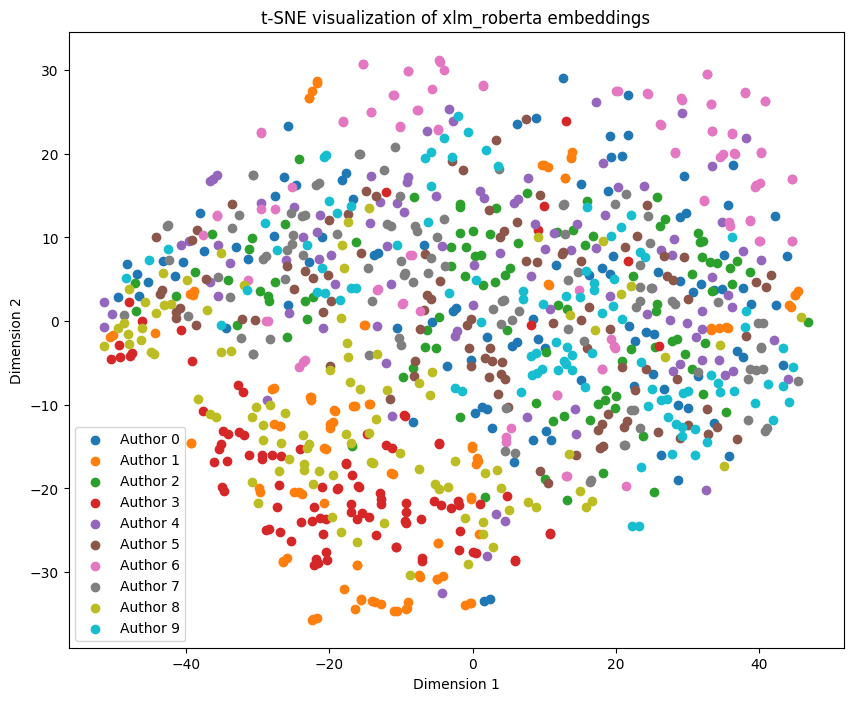

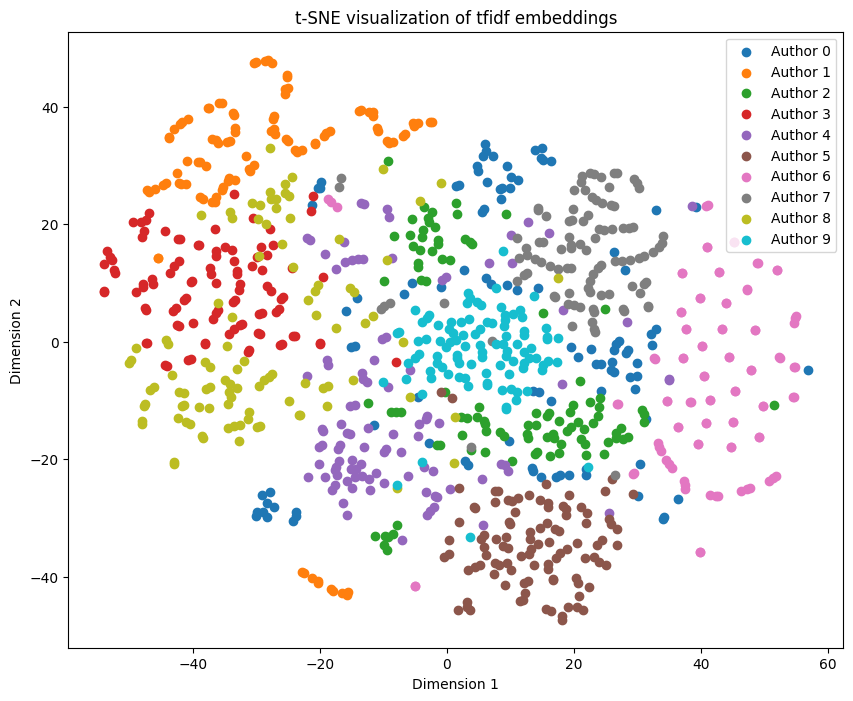

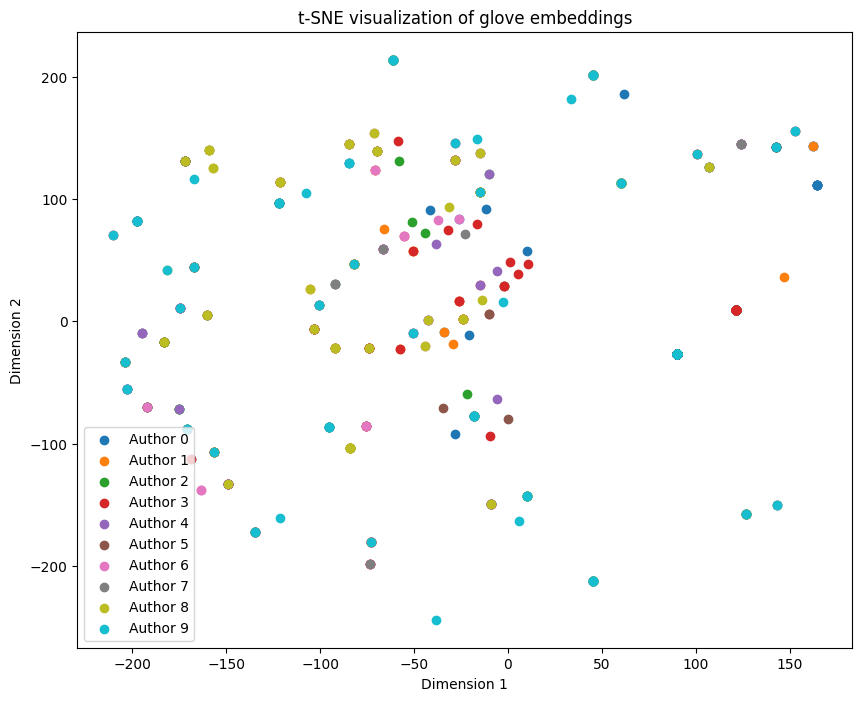

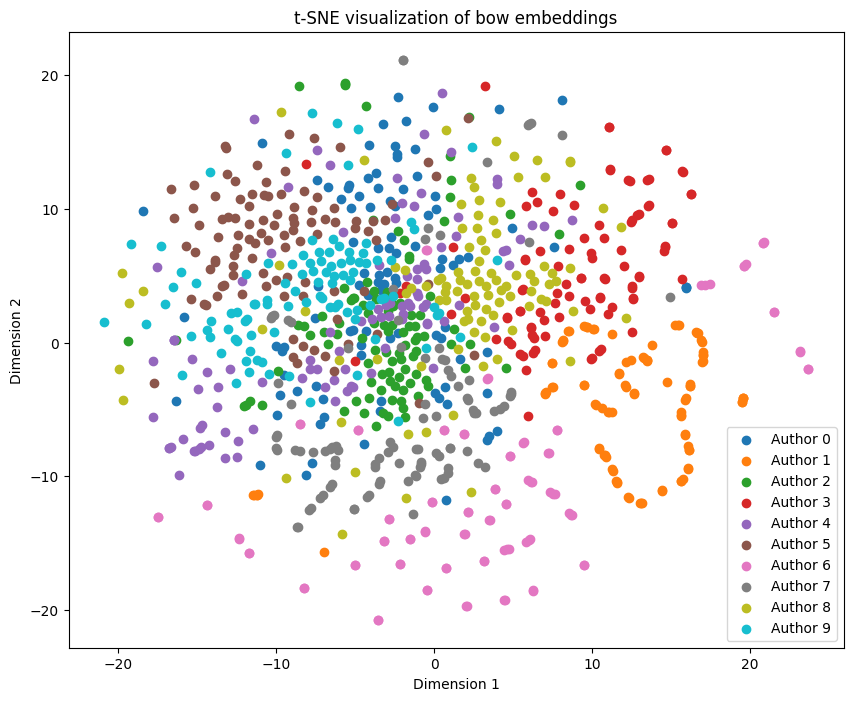

In [74]:
# prompt: visualise the embeddings

import matplotlib.pyplot as plt
from sklearn.manifold import TSNE

def visualize_embeddings(embeddings, labels):
  """Visualizes embeddings using t-SNE."""
  for embedding_type, embedding_matrix in embeddings.items():
    # Convert the list of embeddings to a NumPy array
      embedding_matrix = np.array(embedding_matrix)

        # Check if the embedding matrix has more than one dimension.
        # Reshape to 2D if necessary.
      if embedding_matrix.ndim == 3:
        embedding_matrix = embedding_matrix.reshape(embedding_matrix.shape[0], -1)
      # Reduce dimensionality using t-SNE
      tsne = TSNE(n_components=2, random_state=0)  # Adjust parameters as needed
      embeddings_2d = tsne.fit_transform(embedding_matrix)

      # Create the scatter plot
      plt.figure(figsize=(10, 8))
      for label in set(labels):
          indices = [i for i, l in enumerate(labels) if l == label]
          plt.scatter(embeddings_2d[indices, 0], embeddings_2d[indices, 1], label=f"Author {label}")

      plt.title(f"t-SNE visualization of {embedding_type} embeddings")
      plt.xlabel("Dimension 1")
      plt.ylabel("Dimension 2")
      plt.legend()
      plt.show()


# Load embeddings
# import pickle
# with open('/content/drive/MyDrive/embeddings.pkl', 'rb') as f:
#   embeddings_data = pickle.load(f)

# Assuming you have the labels as a list named 'labels'
visualize_embeddings(embeddings_data, label_100)


## Calculate embeddings

In [ ]:
!pip install scikit-learn

In [ ]:
import sklearn
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer

### 1. Bag of words

In [23]:
import numpy as np

def calculate_bag_of_words(text):
  vectorizer = CountVectorizer()  # Initialize CountVectorizer

    # Check if the text is empty or contains only stop words
  if not text:
      print("Warning: Input text is empty or contains only stop words. Returning an empty array.")
      return np.array([])  # Return an empty array to avoid the error

  preprocess = [preprocess_text(texts) for texts in text]  # Preprocess text
  bow_matrix = vectorizer.fit_transform(preprocess)  # Fit and transform the text
  return bow_matrix.toarray()

### 2. TF-IDF

In [32]:
# def calculate_tfidf(text):
#   vectorizer = TfidfVectorizer()
#   if not text:
#     print("Warning: Input text is empty or contains only stop words. Returning an empty array.")
#     return np.array([])
#   preprocess = [preprocess_text(texts) for texts in text]
#   tfidf_matrix = vectorizer.fit_transform(preprocess)
#   return tfidf_matrix.toarray()

def calculate_tfidf(text):
    """
    Calculates the TF-IDF vectors for the given text.

    Args:
    text (list or str): The input text to be processed. Can be a single string
                        or a list of strings.

    Returns:
    numpy.ndarray: The TF-IDF matrix as a NumPy array.
    """
    preprocess = [preprocess_text(texts) for texts in text]
    tfidf_matrix = vectorizer.fit_transform(preprocess)


    # Convert input to list if it is a string
    if isinstance(text, str):
        text = [text]

    if not text or all(not text_ for text_ in text):
        print("Warning: Input text is empty or contains only stop words. Returning an empty array.")
        return np.array([])

    # Preprocess if input is a list of sentences
    if all(isinstance(item, str) for item in text):
      preprocess = [preprocess_text(texts) for texts in text]
      tfidf_matrix = vectorizer.fit_transform(preprocess)
      return tfidf_matrix.toarray()
    # Preprocess if input is a list of tokens
    else:
      preprocess = [preprocess_text(" ".join(texts)) for texts in text] # Join tokens before preprocessing
      tfidf_matrix = vectorizer.fit_transform(preprocess) # Apply TF-IDF
      return tfidf_matrix.toarray()

In [57]:
len(data_dictionary['MahadeviVerma'][0])
# calculate_tfidf(data_dictionary['MahadeviVerma'])

49

### 3. GloVe

In [33]:
import nltk
nltk.download('punkt')
from gensim.models import Word2Vec


def calculate_glove(text):
  # Split the text into sentences
  sentences = nltk.sent_tokenize(text)

  # Tokenize each sentence into words
  tokenized_sentences = [nltk.word_tokenize(sentence) for sentence in sentences]
  model = Word2Vec(tokenized_sentences, min_count=1)

  word_vector = []
  for sentence in tokenized_sentences:
    for word in sentence:
      try:
        word_vector.append(model.wv[word])
      except KeyError:
        pass
  return word_vector





[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


In [34]:
from sklearn.metrics.pairwise import cosine_similarity

In [35]:
def evaluate_metrics(query_embeddings, reference_embeddings, true_author_indices):
  similarity = cosine_similarity(query_embeddings, reference_embeddings)

  ranks = []
  correct_at_8 = 0
  mrr_sum = 0

  for i, query_similarities in enumerate(similarity):

    true_author_index = true_author_indices[i]

    sorted_indices = np.argsort(query_similarities)[::-1]
    rank = np.where(sorted_indices == true_author_index)[0][0]+1

    ranks.append(rank)

    if rank <= 8:
      rank_at_8 += 1

    mrr_sum += 1/rank

    rank_8 = correct_at_8/len(query_similarities)
    mrr = mrr_sum/len(query_similarities)

  return rank_8, mrr




In [36]:
def evaluate_embeddings(data_dictionary):
  all_text = []
  all_authors = []
  reference_text = []
  reference_authors = []

  for author, texts in data_dictionary.items():
    reference_text.extend(texts[0][:2])
    reference_authors.extend([author]*2)

    all_text.extend(texts[0][2:])
    all_authors.extend([author]*len(texts[2:]))

  methods = {
      'TF-IDF': calculate_tfidf,
      'GloVe': calculate_glove
  }

  results = {}

  for method_name, method in methods.items():
    print(f"\nCalculating {method_name} embeddings...")

    query_embeddings = method(all_text)
    reference_embeddings = method(reference_text)

    print(f"Evaluating {method_name} embeddings...")

    author_to_idx = {author: idx for idx, author in enumerate(all_authors)}
    true_author_indices = [author_to_idx[author] for author in reference_authors]

    rank_8, mrr = evaluate_metrics(query_embeddings, reference_embeddings, all_authors)

    results[method_name] = {
                'Rank@8': rank_8,
                'MRR': mrr
            }

    print(f"{method_name} - Rank@8: {rank_8}, MRR: {mrr}")

  return results

In [37]:
evaluate_embeddings(data_dictionary)


Calculating TF-IDF embeddings...


TypeError: expected string or bytes-like object, got 'list'

In [ ]:
len(data_dictionary.items())

10

In [38]:
reference_text = []
for author, texts in data_dictionary.items():
  reference_text.extend(texts[0][:2])

In [39]:
reference_text

[["बात सुलगी तो बहुत धीरे से थी, लेकिन देखते ही देखते पूरे कस्बे में 'धुआँ' भर गया। चौधरी की मौत सुबह चार बजे हुई थी। सात बजे तक चौधराइन ने रो-धो कर होश सम्भाले और सबसे पहले मुल्ला खैरूद्दीन को बुलाया और नौकर को सख़्त ताकीद की कि कोई ज़िक्र न करे। नौकर जब मुल्ला को आँगन में छोड़ कर चला गया तो चौधराइन मुल्ला को ऊपर ख़्वाबगाह में ले गई, जहाँ चौधरी की लाश बिस्तर से उतार कर ज़मीन पर बिछा दी गई थी। दो सफेद चादरों के बीच लेटा एक ज़रदी माइल सफ़ेद चेहरा, सफेद भौंवें, दाढ़ी और लम्बे सफेद बाल। चौधरी का चेहरा बड़ा नूरानी लग रहा था। मुल्ला ने देखते ही 'एन्नल्लाहे व इना अलेहे राजेउन' पढ़ा, कुछ रसमी से जुमले कहे। अभी ठीक से बैठा भी ना था कि चौधराइन अलमारी से वसीयतनामा निकाल लाई, मुल्ला को दिखाया और पढ़ाया भी। चौधरी की आख़िरी खुवाहिश थी कि उन्हें दफ़न के बजाय चिता पर रख के जलाया जाए और उनकी राख को गाँव की नदी में बहा दिया जाए, जो उनकी ज़मीन सींचती है। मुल्ला पढ़ के चुप रहा। चौधरी ने दीन मज़हब के लिए बड़े काम किए थे गाँव में। हिन्दु-मुसलमान को एकसा दान देते थे। गाँव में कच्ची मस्जिद पक्की करवा दी थी। 

In [53]:
authors = []
stories = []

for author, story_list in data_dictionary.items():
  temp = []
  for story in story_list:
    temp.extend(story)
  stories.extend(temp)
  authors.append([author]*len(story_list))

In [63]:
len(data_dictionary['Gulzar'][0][0])

1

In [54]:
authors

[['Gulzar'],
 ['Harishankar-Parsai'],
 ['Khushwant-Singh'],
 ['MahadeviVerma'],
 ['MunshiPremchand'],
 ['Nirmal-Verma'],
 ['SaadatHasanManto'],
 ['Satyajit-Ray'],
 ['SubhadraKumariChauhan'],
 ['Umashankar-Joshi']]

In [55]:
len(stories)

303

In [50]:
stories[0]

["बात सुलगी तो बहुत धीरे से थी, लेकिन देखते ही देखते पूरे कस्बे में 'धुआँ' भर गया। चौधरी की मौत सुबह चार बजे हुई थी। सात बजे तक चौधराइन ने रो-धो कर होश सम्भाले और सबसे पहले मुल्ला खैरूद्दीन को बुलाया और नौकर को सख़्त ताकीद की कि कोई ज़िक्र न करे। नौकर जब मुल्ला को आँगन में छोड़ कर चला गया तो चौधराइन मुल्ला को ऊपर ख़्वाबगाह में ले गई, जहाँ चौधरी की लाश बिस्तर से उतार कर ज़मीन पर बिछा दी गई थी। दो सफेद चादरों के बीच लेटा एक ज़रदी माइल सफ़ेद चेहरा, सफेद भौंवें, दाढ़ी और लम्बे सफेद बाल। चौधरी का चेहरा बड़ा नूरानी लग रहा था। मुल्ला ने देखते ही 'एन्नल्लाहे व इना अलेहे राजेउन' पढ़ा, कुछ रसमी से जुमले कहे। अभी ठीक से बैठा भी ना था कि चौधराइन अलमारी से वसीयतनामा निकाल लाई, मुल्ला को दिखाया और पढ़ाया भी। चौधरी की आख़िरी खुवाहिश थी कि उन्हें दफ़न के बजाय चिता पर रख के जलाया जाए और उनकी राख को गाँव की नदी में बहा दिया जाए, जो उनकी ज़मीन सींचती है। मुल्ला पढ़ के चुप रहा। चौधरी ने दीन मज़हब के लिए बड़े काम किए थे गाँव में। हिन्दु-मुसलमान को एकसा दान देते थे। गाँव में कच्ची मस्जिद पक्की करवा दी थी। औ